# Jane Street Market Prediction

### 0. Introduction
Jane Street Market Prediction Kaggle Competition is a challenging quantitative trading competition sponsored by Jane Street. Participants are tasked with **building a model that can quickly analyze short-term trade opportunities and determine whether to execute or dismiss** them based on a set of anonymous 130 features.

The competition proves to be challenging owing to the enigmatic nature of certain features, the ever-evolving associations between features and responses, the uncertainty stemming from volatility, the low signal-to-noise ratio, and lastly, the fact that the trading nature of the data may cause it to behave differently in a testing set.

Additionally, **the model must operate in real-time**, with an average iteration time constraint of roughly 16 ms. As opportunities come up one at a time in a loop, the inference is done within this time constraint.

### I. Dataset Exploratory Analysis
#### I.1. Librairies Imports

In [2]:
#pip install missingno

In [3]:
#pip install tqdm

In [4]:
#pip install tensorflow

In [5]:
#pip install datatable

In [6]:
#!pip install xgboost

In [7]:
#pip install -U scikit-learn

In [8]:
#pip install --upgrade scikit-learn

In [9]:
#pip install optuna

In [10]:
import warnings
warnings.filterwarnings('ignore')

import os, gc
import pandas as pd # Data processing
import numpy as np # Linear algebra

import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from joblib import dump, load
import seaborn as sns

%matplotlib inline

import tensorflow as tf
import tensorflow.keras.backend as K
import tensorflow.keras.layers as layers
from tensorflow.keras.callbacks import Callback, ReduceLROnPlateau, ModelCheckpoint, EarlyStopping

# To manipulate Tabular data. It supports out-of-memory datasets, multi-threaded data processing, and flexible API
import datatable as dt

import optuna # Hyperparameters optimization study

In [11]:
from sklearn.impute import SimpleImputer # Data preprocessing tool, imputes missing values (e.g. mean, median, mode)

In [12]:
from pandas.plotting import scatter_matrix, lag_plot
import xgboost as xgb # "eXtreme Gradient Boosting" implementation of boosting gradient, used for regression and classification

from xgboost import plot_importance

import plotly.express as px
import plotly.graph_objects as go
colorMap = sns.light_palette("blue", as_cmap=True)
import missingno as msno
import warnings
warnings.filterwarnings('ignore')

from IPython.display import Image
from scipy import stats

In [13]:
from matplotlib.colors import ListedColormap # Custom colormapping of scalar values to colors

In [14]:
import sklearn

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.utils.validation import has_fit_parameter
from sklearn.utils.validation import _check_psd_eigenvalues
from sklearn.decomposition import PCA
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GroupKFold
from sklearn.svm import SVC

In [15]:
tf.random.set_seed(42)

#### I.2. Upload of Training and Testing datasets

In [16]:
#Boolean variables (not mandatory) allow flexibility and maintenance on the code and program behaviour
TEST = False #program mode test: no
TRAINING = False #program mode train: no
USE_FINETUNE = False #program fine-tuning adjustment: no     
FOLDS = 5 #cross validation split

In [19]:
#train.csv - the training set, contains historical data and returns
train = pd.read_csv('C:/Users/ahwid/Desktop/Dauphine Executive Master IASD/Machine Learning/Machine Learning devoir Jane Street Market Prediction/train.csv')

#example_test.csv - a mock test set which represents the structure of the unseen test set. You will not be directly using the test set or sample submission in this competition, as the time-series API will get/set the test set and predictions.
example_test = pd.read_csv('C:/Users/ahwid/Desktop/Dauphine Executive Master IASD/Machine Learning/Machine Learning devoir Jane Street Market Prediction/example_test.csv')

#example_sample_submission.csv - a mock sample submission file in the correct format
sample_prediction_df = pd.read_csv('C:/Users/ahwid/Desktop/Dauphine Executive Master IASD/Machine Learning/Machine Learning devoir Jane Street Market Prediction/example_sample_submission.csv')

#### I.3. Analyzing Train features & pre-processing

Here we can see that the Training data is very large in size (2GB+). Let's have a synthetic view on the different features :

In [20]:
%time #time execution measure 1000 microseconds

train_rows = len(train)

print("Total Unique Date: ", train['date'].nunique()) # AVG: 4670 samples/date
print("Total Number Of Rows and Columns: ", train.shape)
print('-' * 39)
print("Column Type: ")
print(f"{train.dtypes.value_counts()}")
# Free more space from RAM, useful for big DF
del train_rows

Wall time: 0 ns
Total Unique Date:  500
Total Number Of Rows and Columns:  (2335474, 138)
---------------------------------------
Column Type: 
float64    135
int64        3
dtype: int64


The given training dataset provides roughly 2.5 million data points spanning 500 days (about 2 years), as each year contains 250 trading days approximately.
Dataset: 2GB of Real world financial markets.
* Each row in the dataset represents a trading opportunity, for which we will be predicting an action value: 1 to make the trade and 0 to pass on it ('feature_0')
* Each trade has an associated weight and resp (or gain), which together represents a return on the trade.
* Date column is an integer which represents the day of the trade, while ts_id represents an opportunity time ordering.

In [ ]:
#print(train.columns.to_list())

In [21]:
train.head()

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,...,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
0,0,0.049202,0.002514,0.004059,0.015541,0.024346,0.017530,1,-2.541864,0.457145,...,-1.396750,-1.740766,0.984241,1.055600,-0.079467,-2.650392,-1.981605,1.783659,2.866631,87701
1,0,0.180770,-0.000232,0.000292,0.001638,0.002670,0.000906,1,1.435043,-0.801688,...,2.363126,3.088412,-0.680165,-1.452415,-0.482993,0.021540,0.460060,3.930716,-1.233066,131161
2,0,0.807942,0.000639,0.001136,0.002258,0.000157,-0.000691,1,-1.615491,3.070859,...,1.650663,4.536699,-2.317647,0.789400,0.455739,1.509873,-0.890321,-0.652885,1.805953,1964156
3,0,0.000000,0.003162,0.002086,-0.002512,-0.014387,-0.008368,-1,-3.172026,1.501052,...,-0.743715,0.153879,0.180128,-0.653379,0.809250,-3.604416,-1.060510,4.761398,2.454472,1360299
4,0,0.217674,-0.000255,-0.000340,0.001560,0.004779,0.003217,-1,-3.172026,-0.515529,...,-0.277117,1.552482,-0.348023,-0.944887,3.885566,1.968201,-1.015298,0.642338,0.242971,1024723


##### I.3.1 Data preprocessing & features clean up

In [22]:
from sklearn.preprocessing import StandardScaler # Standardizing features by removing the mean and scaling to unit variance
from sklearn.decomposition import PCA # Used to reduce high-dimensional data dimensionality

In [23]:
# Comprehension list creation from train
features = [c for c in train.columns if 'feature' in c]
XX = train.loc[:, features] # New df
XX = XX.fillna(train.median()) # Filling median values in NA

In [24]:
# Standardizing data by calculating the mean and standard deviation of each col in XX
# Note that the data matrix X_norm must be normalized before applying PCA to ensure that all features are on a similar scale.
scaler = StandardScaler()
scaler.fit(XX)
X_norm = scaler.transform(XX) # XX == with all values scaled to have zero mean and unit variance across all columns

In [25]:
pca = PCA() # Reducing dimensionality while retaining as much information as possible 
X_train_pca = pca.fit_transform(X_norm)

Let's plot the explained variance ratios of the principal components obtained from the PCA transformation of the standardized data X_norm:

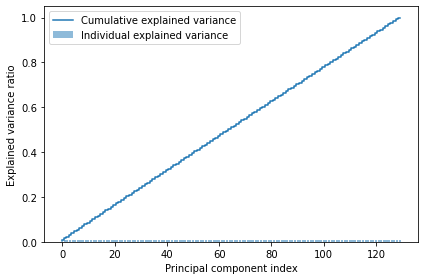

In [26]:
exp_var_pca = pca.explained_variance_ratio_
cum_sum_eigenvalues = np.cumsum(exp_var_pca)

plt.bar(range(0,len(exp_var_pca)), exp_var_pca, alpha = 0.5, align = 'center', label = 'Individual explained variance')
plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where = 'mid',label = 'Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc = 'best')
plt.tight_layout() # Adjusts the spacing between the plot elements
plt.show()
# Creates a bar plot of the individual explained variance of each PC and a step plot of the cumulative explained variance 

This plot is useful for determining how many principal components to retain for further analysis. The plot shows the proportion of the total variance in the data that is explained by each PC and how much variance is explained cumulatively as more PCs are added. The line here proves how difficult is our dataset and adding a PC provides a higher variance. 

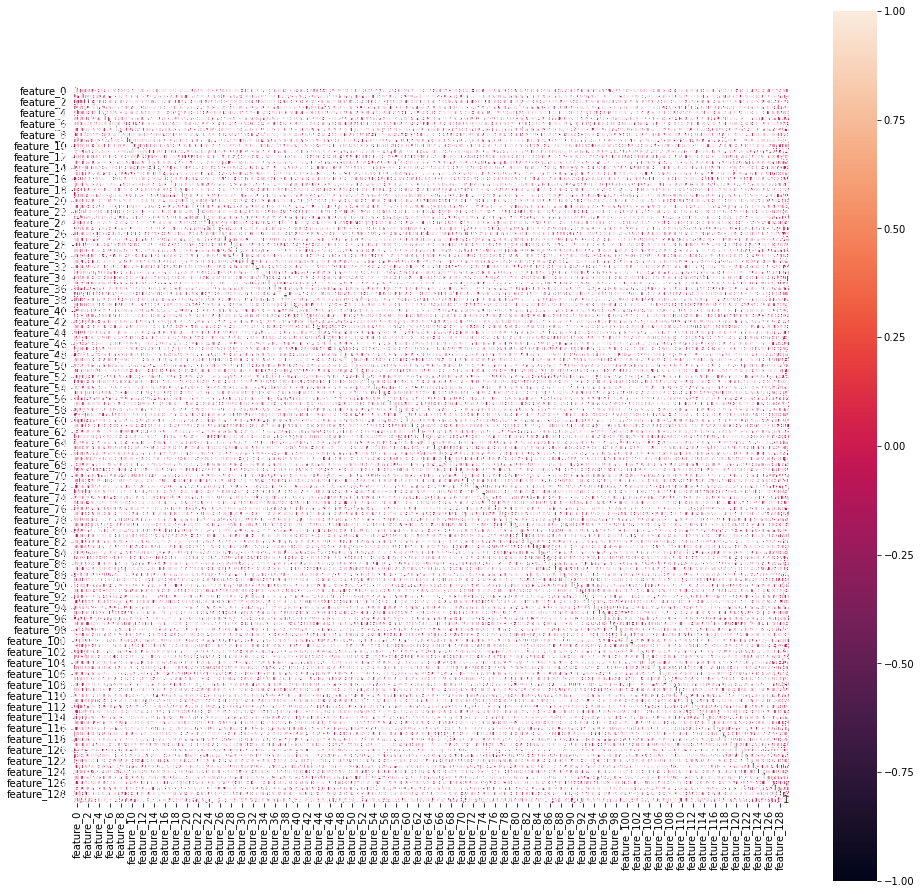

Wall time: 3min 8s


In [40]:
%%time
# Correlation matrix
corrmat =  train.loc[:, features].corr()
fig = plt.figure(figsize = (16, 16))
# vmax and vmin set the maximum and minimum values of the colorbar, 
# square makes the cells in the heatmap square-shaped, and annot displays the correlation coefficients in each cell.
sns.heatmap(corrmat, vmax = 1, square = True, annot = True, vmin = -1) 
plt.show()

##### I.3.2 Optimization : Memory solving issue
So when pandas loads .csv files and encounters floats, it automatically makes them of data type float64.

Since the data we are given by Jane Street has a precision of six digits, float64 is overkill. Using float32 would still maintain all precision but saves half the memory size!

In [27]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2335474 entries, 0 to 2335473
Columns: 138 entries, date to ts_id
dtypes: float64(135), int64(3)
memory usage: 2.4 GB


In [28]:
'''print('float\t\t bytes')
print(np.float64(-0.622475), '\t', np.float64(-0.622475).nbytes)
print(np.float32(-0.622475), '\t', np.float32(-0.622475).nbytes)
print(np.float16(-0.622475), '\t', np.float16(-0.622475).nbytes)'''

"print('float\t\t bytes')\nprint(np.float64(-0.622475), '\t', np.float64(-0.622475).nbytes)\nprint(np.float32(-0.622475), '\t', np.float32(-0.622475).nbytes)\nprint(np.float16(-0.622475), '\t', np.float16(-0.622475).nbytes)"

float64_cols = train.select_dtypes(include='float64').columns
mapper = {col_name: np.float32 for col_name in float64_cols}
train = train.astype(mapper)
train.info()

In [29]:
def reduce_mem_usage(train, verbose = True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = train.memory_usage().sum() / 1024**2    
    for col in train.columns:
        col_type = train[col].dtypes
        if col_type in numerics:
            c_min = train[col].min()
            c_max = train[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    train[col] = train[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    train[col] = train[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    train[col] = train[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    train[col] = train[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    train[col] = train[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    train[col] = train[col].astype(np.float32)
                else:
                    train[col] = train[col].astype(np.float64)    
    end_mem = train.memory_usage().sum() / 1024**2
    if verbose: print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
    return train

In [30]:
train = reduce_mem_usage(train)
features = [c for c in train.columns if 'feature' in c]

Mem. usage decreased to 616.96 Mb (74.9% reduction)


# => That's half the memory usage without almost any loss of precision!

Let's see the distributions of the 'train' dataset variables

Text(0.5, 1.0, 'Distributions of the Date variable')

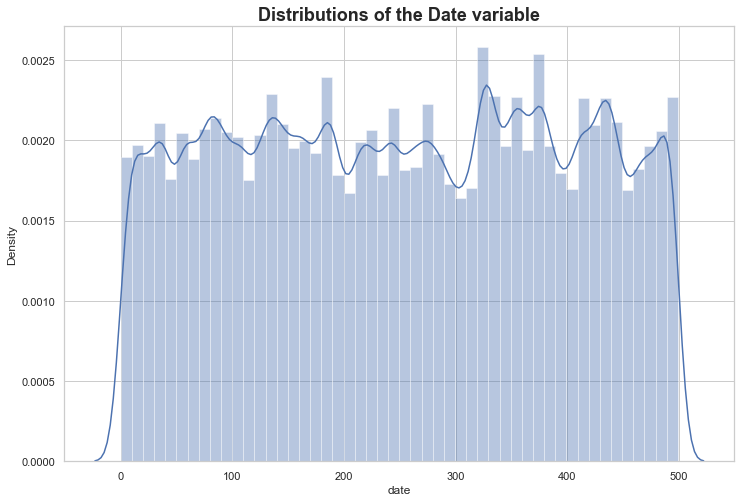

In [16]:
sns.set(rc={'figure.figsize':(12,8)})
sns.set_style("whitegrid", {'axes.grid' : True})

sns.distplot(train['date']).set_title('Distributions of the Date variable', fontweight="bold", size=18)

Each trade opportunity provides a **'date id'** and a trade opportunity id : **'ts_id'** (also anonymized but in chronological order according to Jane Street):

#renaming ts_id to trade_opportunity_ID
train = train.rename(columns = {'trade_opportunity': 'trade_opportunity_ID'})
#train

In [17]:
train.head()

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,...,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
0,0,0.049194,0.002514,0.004059,0.015541,0.024353,0.017532,1,-2.541016,0.457031,...,-1.396484,-1.741211,0.984375,1.055664,-0.079468,-2.650391,-1.981445,1.783203,2.867188,87701
1,0,0.180786,-0.000232,0.000292,0.001637,0.002670,0.000906,1,1.434570,-0.801758,...,2.363281,3.087891,-0.680176,-1.452148,-0.482910,0.021545,0.459961,3.931641,-1.233398,131161
2,0,0.808105,0.000639,0.001137,0.002258,0.000157,-0.000690,1,-1.615234,3.070312,...,1.650391,4.535156,-2.318359,0.789551,0.455811,1.509766,-0.890137,-0.652832,1.805664,1964156
3,0,0.000000,0.003162,0.002087,-0.002512,-0.014389,-0.008369,-1,-3.171875,1.500977,...,-0.743652,0.153931,0.180176,-0.653320,0.809082,-3.603516,-1.060547,4.761719,2.455078,1360299
4,0,0.217651,-0.000255,-0.000340,0.001560,0.004780,0.003218,-1,-3.171875,-0.515625,...,-0.277100,1.552734,-0.348145,-0.944824,3.884766,1.967773,-1.015625,0.642578,0.242920,1024723


##### I.3.1 Features visualization
In addition, we get an anonymized set of **'130 features'** (feature_{0...129}), representing real stock market data with linked trade opportunities. All of them are continuous except for a **binary trade opportunity 'feature_0' having values -1 or +1 which means: BUY OR SELL**.

feature_17     386788
feature_28     386767
feature_27     386401
feature_18     385992
feature_7      384414
                ...  
feature_44        422
feature_3         412
feature_123       214
feature_122       211
feature_59         52
Length: 87, dtype: int64
NAN Valued Columns: 87
Missing data:  2.05%


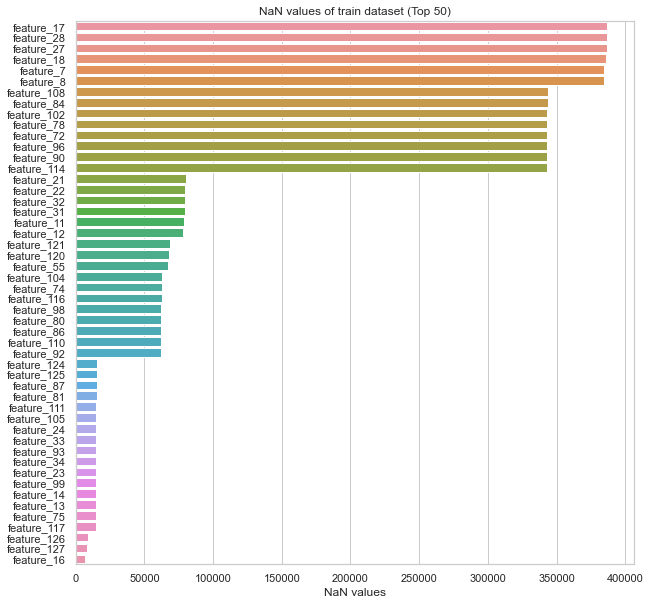

In [18]:
# Missing Data Percentage Count
n_features50 = 50 #top 50 NaN value
missing_values_count = train.isnull().sum()[train.isna().sum() > 0].sort_values(ascending = False)
print(missing_values_count)
total_cells = np.product(train.shape)
total_missing = missing_values_count.sum()
print('NAN Valued Columns: %d' %train.isna().any().sum())
print("Missing data: ", str(round((total_missing/total_cells) * 100, 2)) + "%")


fig, axs = plt.subplots(figsize=(10, 10))

sns.barplot(y = missing_values_count.index[0:n_features50], 
            x = missing_values_count.values[0:n_features50], 
            alpha = 1.0
            )
plt.title(f'NaN values of train dataset (Top {n_features50})')
plt.xlabel('NaN values')
fig.savefig(f'nan_values_top_{n_features50}_features.png')
plt.show()

# Delete unnecessary variable in order to free more space from RAM
del missing_values_count
del total_cells
del total_missing

14 Features present a large amount of NULL value (> 70.000). 2.05% of NULL Values may call for further clearning in the dataset (remove or replace at later stage)

%whos # Check other variables and relative description

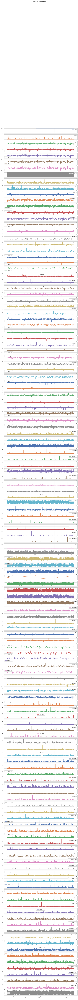

In [19]:
train_features_look = train.tail(5000) #Last 5000 sample lines
train_features_look.plot(kind = 'line', subplots = True, grid=True, title ="Features Visualization", sharex = True, sharey = False, legend = True, figsize = (15,200))
del train_features_look

In [21]:
date = 0
n_features = 130

cols = [f'feature_{i}' for i in range(1, n_features)] #loop
hist = px.histogram(
    train[train["date"] == date], 
    x = cols, #X axis on n_features
    animation_frame = 'variable', 
    range_y=[0, 600], 
    range_x=[-7, 7]
)
hist.show()

In [22]:
train['feature_0'].value_counts() #analysis of BUY or SELL repartition values

 1    1178439
-1    1157035
Name: feature_0, dtype: int64

Cumulated sum graph of feature_0 variable :

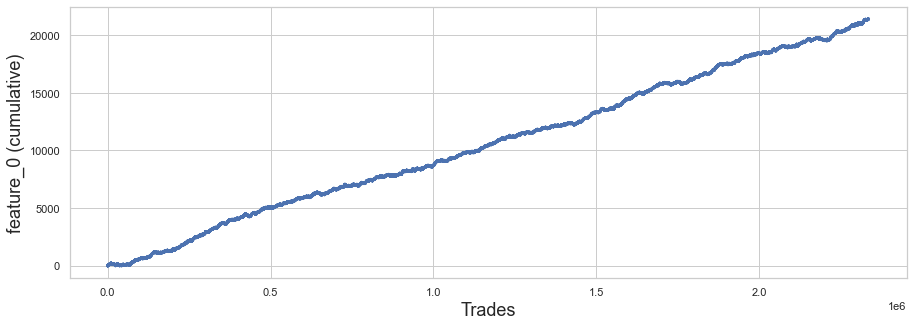

In [23]:
fig, ax = plt.subplots(figsize = (15,5))
feature_0 = pd.Series(train['feature_0']).cumsum()
ax.set_xlabel("Trades", fontsize = 18)
ax.set_ylabel("feature_0 (cumulative)", fontsize = 18);
feature_0.plot(lw = 3); # line width of the bars

There seem to be four general 'types' of features, here is a plot of an example of one of each:

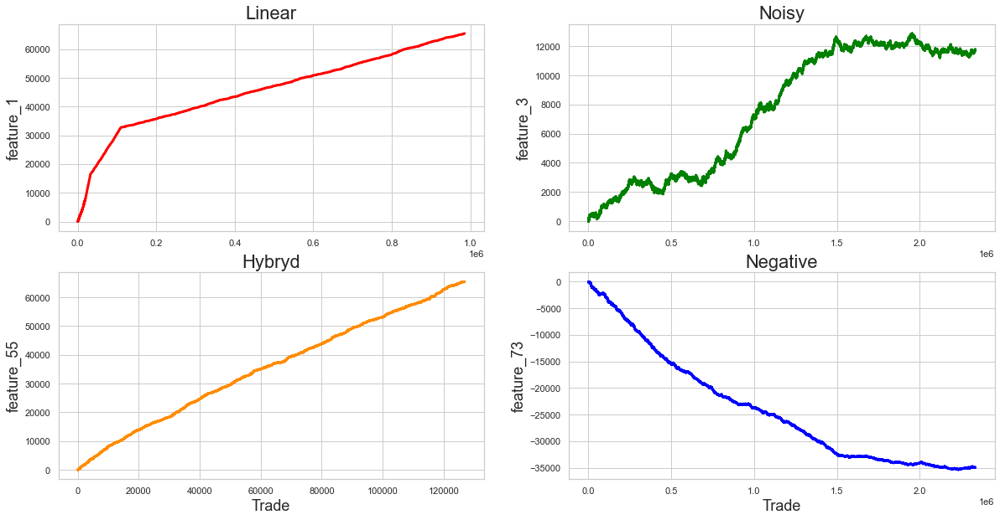

In [24]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2,figsize=(20,10))
#subplots for 4 diff graphs on 2 cols, 2 rows

ax1.plot((pd.Series(train['feature_1']).cumsum()), lw=3, color='red')
ax1.set_title ("Linear", fontsize=22);
ax1.set_ylabel ("feature_1", fontsize=18);

ax2.plot((pd.Series(train['feature_3']).cumsum()), lw=3, color='green')
ax2.set_title ("Noisy", fontsize=22);
ax2.set_ylabel ("feature_3", fontsize=18);

ax3.plot((pd.Series(train['feature_55']).cumsum()), lw=3, color='darkorange')
ax3.set_title ("Hybryd", fontsize=22);
ax3.set_xlabel ("Trade", fontsize=18)
ax3.set_ylabel ("feature_55", fontsize=18);

ax4.plot((pd.Series(train['feature_73']).cumsum()), lw=3, color='blue')
ax4.set_title ("Negative", fontsize=22)
ax4.set_xlabel ("Trade", fontsize=18)
ax4.set_ylabel ("feature_73", fontsize=18);

Further analysis on Features look:

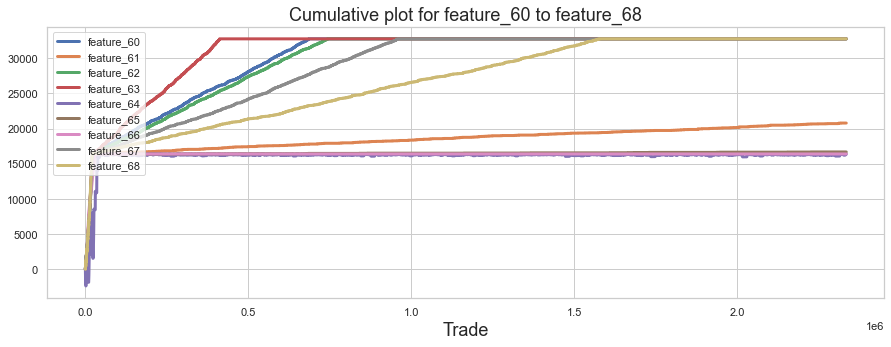

In [25]:
fig, ax = plt.subplots(figsize=(15, 5))
feature_60= pd.Series(train['feature_60']).cumsum()
feature_61= pd.Series(train['feature_61']).cumsum()
feature_62= pd.Series(train['feature_62']).cumsum()
feature_63= pd.Series(train['feature_63']).cumsum()
feature_64= pd.Series(train['feature_64']).cumsum()
feature_65= pd.Series(train['feature_65']).cumsum()
feature_66= pd.Series(train['feature_66']).cumsum()
feature_67= pd.Series(train['feature_67']).cumsum()
feature_68= pd.Series(train['feature_68']).cumsum()
#feature_69= pd.Series(train['feature_69']).cumsum()
ax.set_xlabel ("Trade", fontsize=18)
ax.set_title ("Cumulative plot for feature_60 to feature_68", fontsize=18)
feature_60.plot(lw=3)
feature_61.plot(lw=3)
feature_62.plot(lw=3)
feature_63.plot(lw=3)
feature_64.plot(lw=3)
feature_65.plot(lw=3)
feature_66.plot(lw=3)
feature_67.plot(lw=3)
feature_68.plot(lw=3)
plt.legend(loc="upper left");
#gc.collect();

#### Noisy features 3, 4, 5, 6 are plotted below

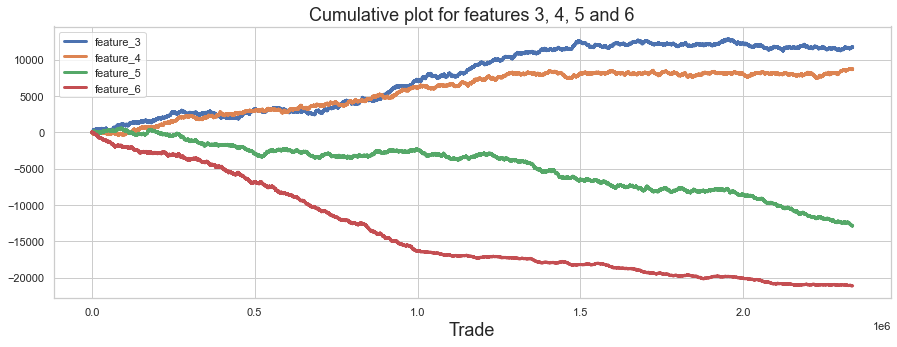

In [26]:
fig, ax = plt.subplots(figsize=(15, 5))
feature_3= pd.Series(train['feature_3']).cumsum()
feature_4= pd.Series(train['feature_4']).cumsum()
feature_5= pd.Series(train['feature_5']).cumsum()
feature_6= pd.Series(train['feature_6']).cumsum()
ax.set_xlabel ("Trade", fontsize=18)
ax.set_title ("Cumulative plot for features 3, 4, 5 and 6", fontsize=18)
feature_3.plot(lw=3)
feature_4.plot(lw=3)
feature_5.plot(lw=3)
feature_6.plot(lw=3)
plt.legend(loc="upper left");
#gc.collect();

#### 'Negative' features :

Features 73, 75, 76, 77 (noisy), 79, 81(noisy), 82.

These are all found in the Tag 23 section.

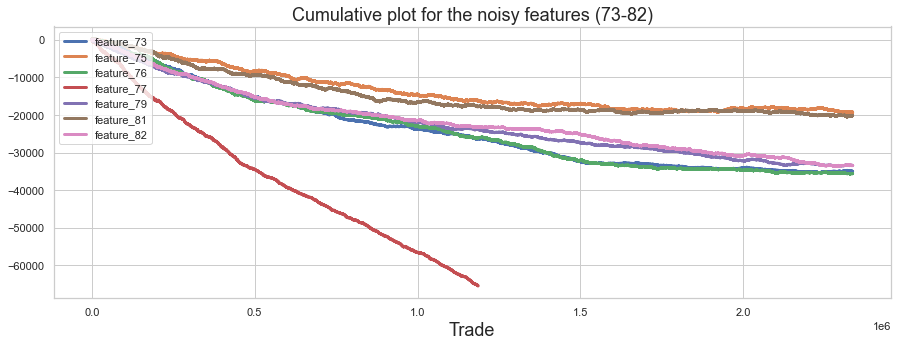

In [27]:
fig, ax = plt.subplots(figsize=(15, 5))
feature_73= pd.Series(train['feature_73']).cumsum()
feature_75= pd.Series(train['feature_75']).cumsum()
feature_76= pd.Series(train['feature_76']).cumsum()
feature_77= pd.Series(train['feature_77']).cumsum()
feature_79= pd.Series(train['feature_79']).cumsum()
feature_81= pd.Series(train['feature_81']).cumsum()
feature_82= pd.Series(train['feature_82']).cumsum()
ax.set_xlabel ("Trade", fontsize=18)
ax.set_title ("Cumulative plot for the noisy features (73-82)", fontsize=18)
feature_73.plot(lw=3)
feature_75.plot(lw=3)
feature_76.plot(lw=3)
feature_77.plot(lw=3)
feature_79.plot(lw=3)
feature_81.plot(lw=3)
feature_82.plot(lw=3)
plt.legend(loc="upper left");

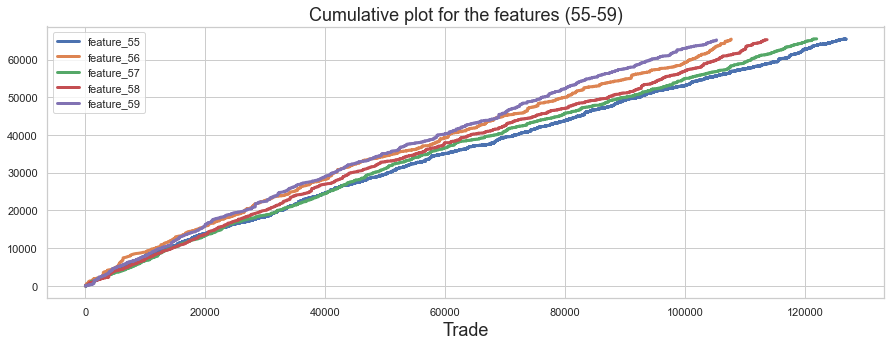

In [28]:
fig, ax = plt.subplots(figsize=(15, 5))
feature_55= pd.Series(train['feature_55']).cumsum()
feature_56= pd.Series(train['feature_56']).cumsum()
feature_57= pd.Series(train['feature_57']).cumsum()
feature_58= pd.Series(train['feature_58']).cumsum()
feature_59= pd.Series(train['feature_59']).cumsum()
ax.set_xlabel ("Trade", fontsize=18)
ax.set_title ("Cumulative plot for the features (55-59)", fontsize=18)
feature_55.plot(lw=3)
feature_56.plot(lw=3)
feature_57.plot(lw=3)
feature_58.plot(lw=3)
feature_59.plot(lw=3)
plt.legend(loc="upper left");

##### I.3.2 Analysis of "Resp_i" timeframes
The response variable **'resp'** represents a trade and its associated **profit/loss per security unit in four specific fixed time horizon** (resp_1 > resp_2 > resp_3 > resp_4) determined by Jane Street. The profit/loss of a trade is then **= weighted * response**.

we are trying to decide whether to make the trade or not (action = 1 for making the trade, action = 0 for not making the trade).

*Unfortunately, it doesn't seem as if we have been given any information on what these time horizons are. While their actual numbers might not be crucial, the relationship between them could be very useful. In this notebook, we'll try to make a rough estimate of their relative ordering and how they relate to the trades time spans.*

In the next part, we will try to make a first estimate of their relative ordering and how they relate to the trades time spans.

In [29]:
train_features_look = train.drop(['resp', 'resp_1','resp_2','resp_3','resp_4'], axis=1)
print(train_features_look.head(5)) #132 columns, 130 features
del train_features_look

   date    weight  feature_0  feature_1  feature_2  feature_3  feature_4  \
0     0  0.049194          1  -2.541016   0.457031   0.205688   0.360840   
1     0  0.180786          1   1.434570  -0.801758   0.996094  -2.267578   
2     0  0.808105          1  -1.615234   3.070312   0.551758   0.402832   
3     0  0.000000         -1  -3.171875   1.500977  -0.714844   0.559082   
4     0  0.217651         -1  -3.171875  -0.515625  -2.316406  -1.253906   

   feature_5  feature_6  feature_7  ...  feature_121  feature_122  \
0  -0.474121   0.799316  -4.371094  ...    -1.396484    -1.741211   
1   0.446045   3.177734   3.685547  ...     2.363281     3.087891   
2  -2.152344  -1.472656  -1.684570  ...     1.650391     4.535156   
3   3.521484   0.348389        NaN  ...    -0.743652     0.153931   
4   0.653320  -0.504395        NaN  ...    -0.277100     1.552734   

   feature_123  feature_124  feature_125  feature_126  feature_127  \
0     0.984375     1.055664    -0.079468    -2.650391    -

At the beginning, we could assumed that 'resp' is just a simple average of resp_1, resp_2, resp_3, and resp_4. Using Ordinary Least Squares (OLS) to perform a linear regression on my resp variables, this suggests this is not the case:

In [30]:
import statsmodels.api as sm

# Selection of independent and dependent variables
y = train["resp"] #dependent variable
X = train[["resp_1", "resp_2", "resp_3", "resp_4"]]

# Add a constant to the matrix X to get the intercept in the regression
X = sm.add_constant(X)

# Fit the OLS model
model = sm.OLS(y, X).fit()

# Display the results of the regression
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                   resp   R-squared:                       0.964
Model:                            OLS   Adj. R-squared:                  0.964
Method:                 Least Squares   F-statistic:                 1.560e+07
Date:                Sun, 05 Mar 2023   Prob (F-statistic):               0.00
Time:                        05:32:39   Log-Likelihood:             9.0051e+06
No. Observations:             2335474   AIC:                        -1.801e+07
Df Residuals:                 2335469   BIC:                        -1.801e+07
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        4.38e-06   3.35e-06      1.307      0.1

Let's now have a **Cumulative return plot** of our different investment strategies 'resp_' variables and over given time horizons: 1,2,3 and 4 (500 days)

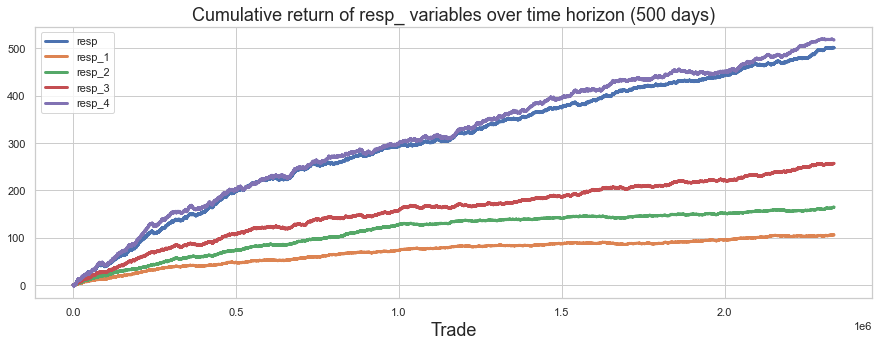

In [31]:
fig, ax = plt.subplots(figsize = (15, 5)) #length, height
resp = pd.Series(train['resp']).cumsum() #cumulative sum of each investment strategy
resp_1 = pd.Series(train['resp_1']).cumsum()
resp_2 = pd.Series(train['resp_2']).cumsum()
resp_3 = pd.Series(train['resp_3']).cumsum()
resp_4 = pd.Series(train['resp_4']).cumsum()
ax.set_xlabel ("Trade", fontsize = 18)
ax.set_title ("Cumulative return of resp_ variables over time horizon (500 days)", fontsize = 18)
resp.plot(lw = 3) #plot of cumulative sum
resp_1.plot(lw = 3)
resp_2.plot(lw = 3)
resp_3.plot(lw = 3)
resp_4.plot(lw = 3)
plt.legend(loc = "upper left");

Here is a histogram plot of the distribution of 'resp' values, with 3000 bins and a range of (-0.05, 0.05). The color of each bin is based on its frequency, with a gradient ranging from minimum to maximum frequency:

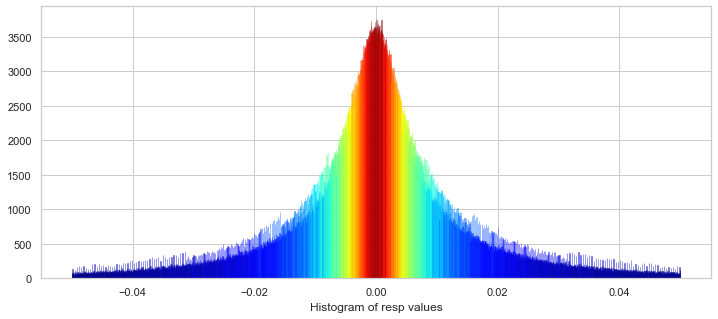

In [32]:
# Generation of a histogram of the 'resp' values/ color scheme based on the height of the bars. 
plt.figure(figsize = (12,5))
ax = sns.distplot(train['resp'], 
             bins = 3000, 
             kde_kws = {"clip":(-0.05,0.05)}, 
             hist_kws = {"range":(-0.05,0.05)},
             color = 'darkcyan', 
             axlabel = "Histogram of resp values",
             kde = False);
values = np.array([rec.get_height() for rec in ax.patches])
norm = plt.Normalize(values.min(), values.max())
colors = plt.cm.jet(norm(values))
for rec, col in zip(ax.patches, colors):
    rec.set_color(col)
plt.show();

This distribution has very long tails..resp min and max values could also be insightful for the rest of the analysis:

In [33]:
min_resp = train['resp'].min()
#The minimum value for 'resp' is printed with 5 decimal places
print('The minimum value for resp is: %.2f' % min_resp)

max_resp = train['resp'].max()
# The maximum value for 'resp' is printed with 5 decimal places
print('The maximum value for resp is:  %.2f' % max_resp)

The minimum value for resp is: -0.48
The maximum value for resp is:  0.41


In [34]:
# Outputs the skewness and kurtosis values of the 'resp' variable in the 'train' dataset
# Values are printed with 2 decimal places 
print("Skew of resp is:     %.2f" %train['resp'].skew() )
print("Kurtosis of resp is: %.2f"  %train['resp'].kurtosis() )

Skew of resp is:     nan
Kurtosis of resp is: nan


##### I.3.3 The importance of the Weight variable 
Each trade has an associated weight and resp, which multiplied together represents the return on the trade. For the sake of completeness, trades with weight = 0 were included in the dataset although such trades will not contribute towards the scoring evaluation, so that might be useful to remove these variables to gain some memory into the dataset:

In [35]:
percent_zeros = (100/train.shape[0])*((train.weight.values == 0).sum())
print('Percentage of zero weights is: %i' % percent_zeros +"%")

Percentage of zero weights is: 17%


For a better overview, weights measures could be also interesting to see:

In [36]:
min_weight = train['weight'].min()
print('The minimum weight is: %.2f' % min_weight)

The minimum weight is: 0.00


In [37]:
max_weight = train['weight'].max()
print('The maximum weight is: %.2f' % max_weight)

The maximum weight is: 167.25


Which occurs on days 123 and 249 :

In [38]:
train[train['weight'] == train['weight'].max()]

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,...,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
567045,123,167.25,0.006084,0.007149,0.020111,0.033966,0.025467,-1,1.766602,-2.375000,...,0.613281,0.612793,-0.590332,1.454102,-2.000000,-1.219727,-1.489258,1.927734,0.429199,1183751
1155314,249,167.25,0.003496,0.006359,-0.013527,-0.057159,-0.035156,-1,1.576172,0.635254,...,-3.357422,1.561523,2.310547,-0.392578,-0.619629,-0.286621,2.175781,-1.581055,0.114685,1148851


In [39]:
train[train['weight'] > 150] #107 dates contains an associated weight > 150

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,...,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
4035,1,155.750,-0.000380,-0.000494,-0.005398,0.012650,0.012825,1,3.890625,0.822266,...,0.392090,3.908203,0.282959,-1.143555,2.919922,1.251953,-0.155762,0.076599,-1.390625,218239
11040,2,150.625,0.000472,0.000286,0.000361,0.001065,0.001179,1,3.318359,-2.279297,...,1.598633,2.548828,0.063354,-0.312012,1.554688,2.453125,0.886719,-0.978516,1.625000,1197274
30818,7,162.500,-0.001818,-0.002466,-0.001222,0.001429,0.000209,1,0.970703,0.412109,...,-3.003906,-0.197266,-0.068176,0.537109,-0.295410,0.904785,-0.069580,-0.305420,0.030930,393421
48092,10,155.625,0.001454,0.008369,0.009933,0.007835,0.013451,1,3.451172,3.986328,...,-0.188843,-0.400391,-0.243042,0.757324,0.445312,-0.682129,3.345703,0.855469,0.391846,1465200
55552,12,153.000,0.001368,0.001471,0.001080,0.001440,0.001769,-1,-0.143311,0.521484,...,7.496094,5.101562,0.176636,-1.035156,0.308838,1.680664,-1.500977,0.003109,-1.060547,1934836
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2210680,474,153.000,0.005886,0.010612,0.020233,0.033478,0.030411,1,0.886230,-1.829102,...,-1.294922,-2.263672,-1.824219,0.160767,0.698730,-0.195557,-2.039062,-2.710938,3.609375,1964403
2219670,476,153.375,0.001532,0.000020,0.000946,-0.004799,-0.008156,-1,-3.171875,-1.250000,...,-0.908691,-1.887695,-1.835938,3.314453,1.002930,-0.086182,-1.322266,-0.785156,-0.359619,1356460
2287466,491,156.250,-0.003757,-0.007568,-0.012482,-0.009521,-0.003626,1,-1.741211,2.244141,...,0.469727,-0.085693,-0.949219,-1.143555,4.117188,0.764160,-2.054688,1.866211,0.724609,1643062
2288593,491,158.875,-0.003056,-0.006199,0.006210,0.033295,0.024628,-1,-0.791016,-0.136963,...,-1.130859,-0.326416,4.796875,2.136719,-0.184814,-3.570312,-0.633789,-0.117737,-0.375488,2034666


Let's plot a histogram of the non-zero weights with matplotib and seaborn libraries:

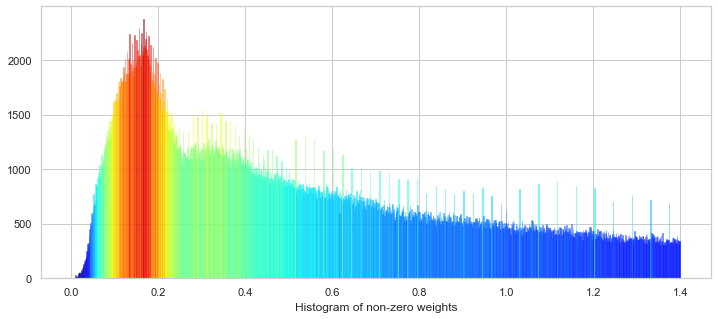

In [40]:
plt.figure(figsize = (12,5))
ax = sns.distplot(train['weight'], # distrib plot with distplot fct
                  bins = 1400, # divide the range on a number of intervals.
                  kde_kws = {"clip":(0.001,1.4)}, # kernel parameters
                  hist_kws = {"range":(0.001,1.4)}, # kernel parameters 
                  color = 'darkcyan',
                  axlabel = "Histogram of non-zero weights",
                  kde = False); # hiding kernel density plots        
values = np.array([rec.get_height()for rec in ax.patches]) # extracts the height of each bar in the histogram plot using a list comprehension
norm = plt.Normalize(values.min(), values.max()) # normalizes the values in values to be in the range of 0 to 1
colors = plt.cm.jet(norm(values))
for rec, col in zip(ax.patches, colors):
    rec.set_color(col) # sets the color of each bar in the histogram based on the colors generated in the previous step
plt.show();

Here we can observe two peaks, one situated at weight close to 0.17, and a lower broader peak at weight close to 0.30 : the assumption could be an indication of two different superimposed underlying distributions?

**Let's see how 'weight' and 'resp' variables are distributed:**

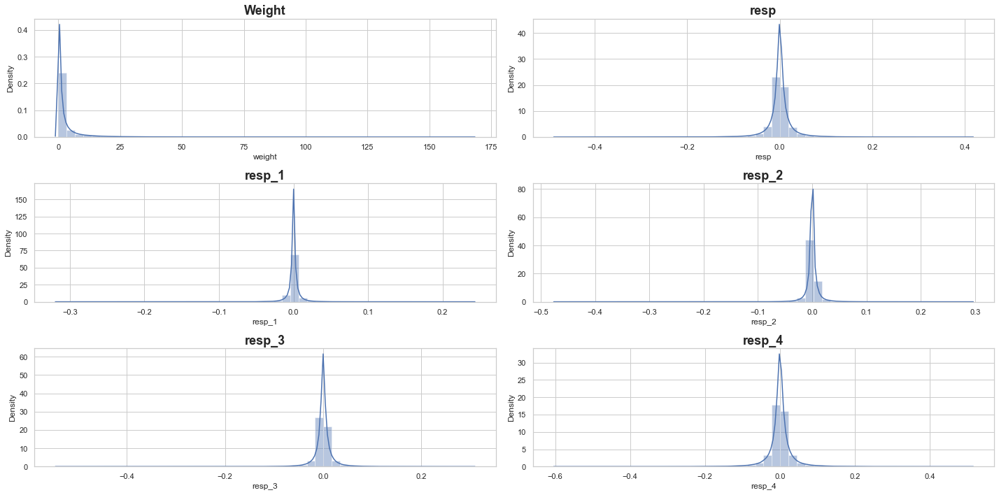

In [41]:
fig, axs = plt.subplots(nrows = 3, ncols = 2, figsize = (20,10))
sns.distplot(train['weight'], ax = axs[0][0]).set_title('Weight', fontweight = "bold", size=18)
sns.distplot(train['resp'], ax = axs[0][1]).set_title('resp', fontweight = "bold", size=18)
sns.distplot(train['resp_1'], ax = axs[1][0]).set_title('resp_1', fontweight = "bold", size=18)
sns.distplot(train['resp_2'], ax = axs[1][1]).set_title('resp_2', fontweight = "bold", size=18)
sns.distplot(train['resp_3'], ax = axs[2][0]).set_title('resp_3', fontweight = "bold", size=18)
sns.distplot(train['resp_4'], ax = axs[2][1]).set_title('resp_4', fontweight = "bold", size=18)
    
plt.tight_layout()

##### I.3.4 Exploratory Analysis for resp_ and weight variables¶

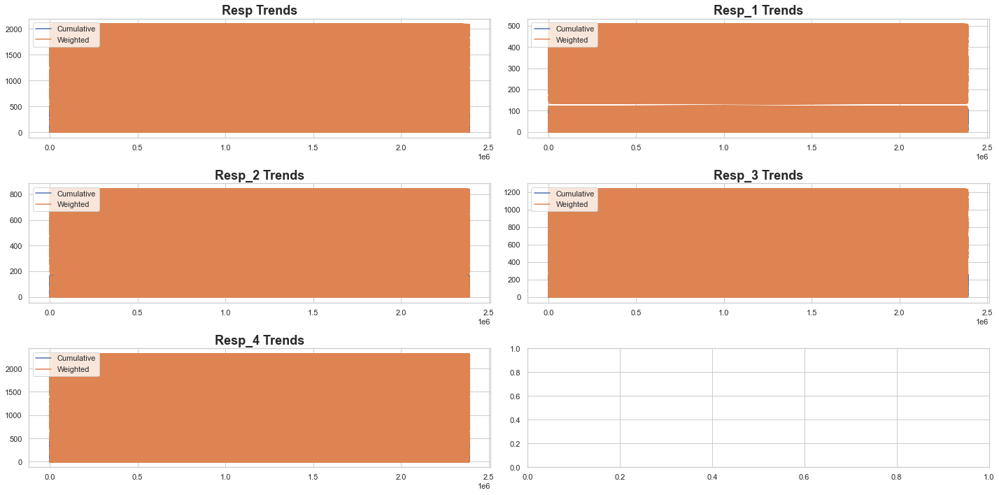

In [42]:
import matplotlib.pyplot as plt
import pandas as pd
import gc

# Select resp_i headers
train_resp = ['resp', 'resp_1', 'resp_2', 'resp_3', 'resp_4']

# Set up figure
fig, axs = plt.subplots(nrows = 3, ncols = 2, figsize = (20, 10))

# Plot each variable and looping in resp_i variables
for i, resp in enumerate(train_resp):
    row = i // 2
    col = i % 2

    # Calculate trends within the for loop
    trend = train[resp].cumsum()
    weighted_trend = (train['weight'] * train[resp]).cumsum()

    # Plot trends
    axs[row, col].plot(train['ts_id'], trend, label = 'Cumulative')
    axs[row, col].plot(train['ts_id'], weighted_trend, label = 'Weighted')
    axs[row, col].set_title(f'{resp.capitalize()} Trends', fontsize = 18, fontweight = 'bold')
    axs[row, col].legend(loc = 'upper left')

    # Remove calculated columns to free memory
    train = train.drop(columns = ['trend', 'weighted_trend'], errors = 'ignore')
    gc.collect()

# Adjust layout and show plot
plt.tight_layout()
plt.show()


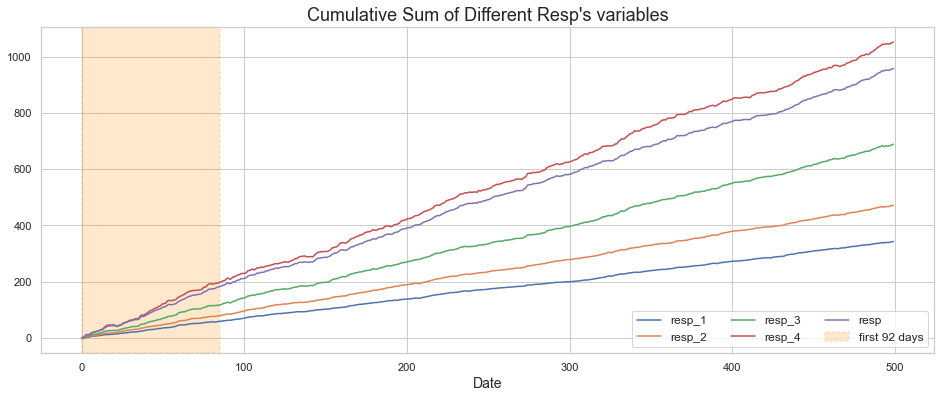

In [43]:
fig = plt.figure(figsize = (16, 6)) #graph size 16,6
ax = plt.subplot(1,1,1) #sub graph
train.groupby('date')[['resp_1', 'resp_2', 'resp_3', 'resp_4', 'resp']].sum().cumsum().plot(ax = ax) #cumsum of resp_i
plt.title('Cumulative Sum of Different Resp\'s variables', fontsize = 18)
plt.xlabel('Date',fontsize = 14)
plt.axvspan(0,85, linestyle = ':',linewidth = 2,label = 'first 92 days', color ='darkorange',alpha = .2) #split of first 92 days 
plt.legend(fontsize = 12, ncol = 3, loc = 'lower right'); #legend

* more gains in the first 92 days :-> it may be a good idea to drop the observations before this point,
* resp_4 has the highest cumulative sum.
* resp_1 has the smallest cumulative sum.

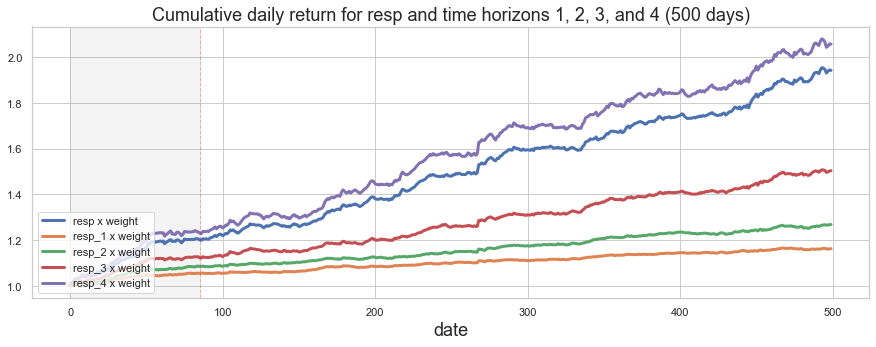

In [44]:
#columns addition weight_resp_i
train['weight_resp']   = train['weight']*train['resp']
train['weight_resp_1'] = train['weight']*train['resp_1']
train['weight_resp_2'] = train['weight']*train['resp_2']
train['weight_resp_3'] = train['weight']*train['resp_3']
train['weight_resp_4'] = train['weight']*train['resp_4']

fig, ax = plt.subplots(figsize=(15, 5))
resp    = pd.Series(1+(train.groupby('date')['weight_resp'].mean())).cumprod()
resp_1  = pd.Series(1+(train.groupby('date')['weight_resp_1'].mean())).cumprod()
resp_2  = pd.Series(1+(train.groupby('date')['weight_resp_2'].mean())).cumprod()
resp_3  = pd.Series(1+(train.groupby('date')['weight_resp_3'].mean())).cumprod()
resp_4  = pd.Series(1+(train.groupby('date')['weight_resp_4'].mean())).cumprod()
ax.set_xlabel ("Day", fontsize=18)
ax.set_title ("Cumulative daily return for resp and time horizons 1, 2, 3, and 4 (500 days)", fontsize=18)
resp.plot(lw=3, label='resp x weight')
resp_1.plot(lw=3, label='resp_1 x weight')
resp_2.plot(lw=3, label='resp_2 x weight')
resp_3.plot(lw=3, label='resp_3 x weight')
resp_4.plot(lw=3, label='resp_4 x weight')
# day 85 marker
ax.axvline(x=85, linestyle='--', alpha=0.3, c='red', lw=1)
ax.axvspan(0, 85 , color=sns.xkcd_rgb['grey'], alpha=0.1)
plt.legend(loc="lower left");
# Delete Unnecessary Variables
train = train.drop(columns=['weight_resp','weight_resp_1','weight_resp_2', 'weight_resp_3','weight_resp_4'], axis=1)
del resp, resp_1, resp_2, resp_3, resp_4

* We can see that the shortest time horizons, resp_1, resp_2 and resp_3, representing a more conservative strategy, result in the lowest return.

Let's look at the evolution of the daily average of : 'resp_1', 'resp_2', 'resp_3', 'resp_4' and 'resp':

In [45]:
fig = px.line(train.groupby('date')[['resp_1', 'resp_2', 'resp_3', 'resp_4','resp']].mean(),
               x = train.groupby('date')[['resp_1', 'resp_2', 'resp_3', 'resp_4','resp']].mean().index,
               y = ['resp_1', 'resp_2', 'resp_3', 'resp_4','resp'],
               title = 'Average Return per day')
fig.layout.xaxis.title = 'Day' 
fig.layout.yaxis.title = 'Avg Resp'
fig.show()

In [46]:
import plotly.express as px

df_mean = train.groupby('date')[['resp_1', 'resp_2', 'resp_3', 'resp_4','resp']].mean().reset_index()
df_melt = pd.melt(df_mean, id_vars=['date'], value_vars=['resp_1', 'resp_2', 'resp_3', 'resp_4', 'resp'], var_name='resp', value_name='avg_resp')

fig = px.line(df_melt, x='date', y='avg_resp', color='resp', title='Average Return per day')
fig.layout.xaxis.title = 'Day'
fig.layout.yaxis.title = 'Avg Resp'
fig.show()

##### I.3.5 descriptive statistics for each column 'resp_1, resp_2, resp_3, resp_4 and resp'

In [47]:
def standard_dev(x): #x being a classic dataframe
    x2 = x.copy() #x2 being a copy of x
    #loc indexation by col name =! iloc indexation by col number
    x2.loc[: , :] = '' #set all values of x2 to empty cells
    x2.iloc[::,2] = 'background-color: orange' #selection of all rows & only the 3rd column of the dataframe
    return x2

temp = train[['resp_1', 'resp_2', 'resp_3', 'resp_4', 'resp']].describe().T #tranposed df called temp with all calculation made on stats
temp.style.apply(standard_dev, axis = None) #style.apply method used to apply the highlight function with axis = None : which means that function to be applied to all cells of the df

,count,mean,std,min,25%,50%,75%,max
resp_1,2335474.000000,0.000146,0.008919,-0.318115,-0.001859,0.000047,0.002098,0.242065
resp_2,2335474.000000,0.000202,0.012276,-0.474121,-0.002665,0.000070,0.002945,0.294922
resp_3,2335474.000000,0.000295,0.019119,-0.542969,-0.005020,0.000119,0.005482,0.306641
resp_4,2335474.000000,0.000450,0.032928,-0.598633,-0.009300,0.000123,0.009819,0.511230
resp,2335474.000000,0.000410,0.027008,-0.483887,-0.007156,0.000088,0.007549,0.413818


We can observe a very low standard deviation of the resp_i variables where resp_4 still presents highest STD, indicating a relatively low variability in the investing strategy. The values are more consistent and less spread out within the given time horizon.

We can display a triangular matrix of scatter plots to investigate the relationships between the 5 'resp' variables simultaneously. The scatter plots in the matrix depict the relationship between the 'resp' variables, and the diagonal plots illustrate the distribution of each variable. This approach can facilitate the identification of any potential patterns or correlations within the dataset:

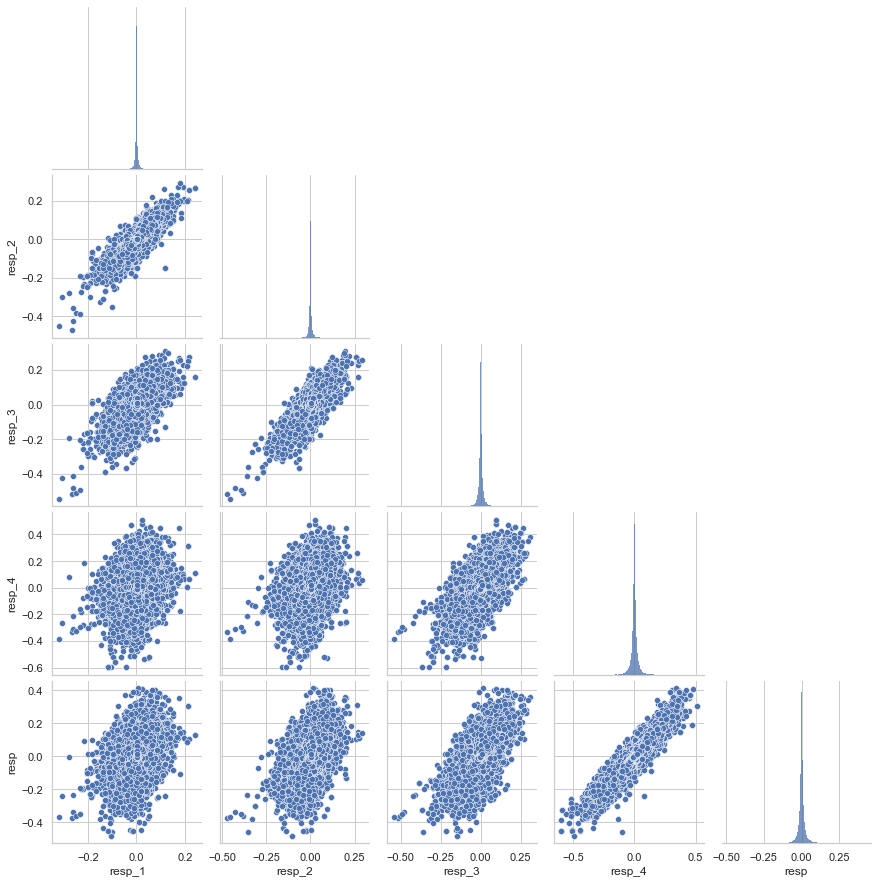

In [48]:
# Matrix of scatterplots: pairplot (library Seaborn)
sns.pairplot(train[['resp_1', 'resp_2', 'resp_3', 'resp_4', 'resp']], corner = True )

We can clearly see at the right bottom of the scatter plot that 

* **resp is highly related to resp_4** and,

* **resp_1 and resp_2 are highly related**

Let's see the evolution of the number of transactions over the time period covered by the dataset and resp variables:

In [49]:
#Investment Time Horizon
fig = px.area(data_frame= train.groupby('date')[['resp']].count(),title='Number of operation per day')
fig.update_traces(showlegend = False)
fig.layout.xaxis.title = 'Day' 
fig.layout.yaxis.title = 'Number of operations'
fig.show()

In [50]:
fig = px.area(data_frame = train.groupby('date')[['resp']].sum(),title = 'Resp sum of operation per day')
fig.update_traces( showlegend = False)
fig.layout.xaxis.title = 'Day' 
fig.layout.yaxis.title = 'Resp sum'
fig.show()

In [51]:
# Clean up of the data by converting resp_ columns into "long" format to make the analysis more handy
train_resp = train.loc[:, ["resp", "resp_1", "resp_2", "resp_3", "resp_4"]] #selection of resp_i headers

cols = ["resp", "resp_1", "resp_2", "resp_3", "resp_4"]
train_resp[cols] = train_resp[cols].astype(float) #normalization of resp_i columns

train_resp = (train_resp.assign(**{col: train_resp[col] / train_resp["resp"] for col in cols[1:]})
              .drop("resp", axis = 1))

train_resp = train_resp.melt(id_vars = [col for col in train_resp.columns if col not in cols[1:]], 
                              value_vars = [col for col in cols[1:]], 
                              var_name = "i", 
                              value_name = "t")
train_resp["i"] = train_resp["i"].str.extract("(\d+)").astype(int)

In [52]:
print(train_resp.head(5)) #The column i defines the different groups for which the distributions are plotted.

   i         t
0  1  0.143386
1  1 -0.256187
2  1 -0.925414
3  1 -0.377849
4  1 -0.079283


In [53]:
#and we see that all we have to do for a first estimate of the time horizons of the resp_i (==ti) is to see if resp_i / resp is meaningfully distributed.
train_resp

,i,t
0,1,0.143386
1,1,-0.256187
2,1,-0.925414
3,1,-0.377849
4,1,-0.079283
...,...,...
9341891,4,6.033718
9341892,4,1.794693
9341893,4,0.935425
9341894,4,3.821625


Let's create a density graph using the ggplot2 library to visualize the estimation time distributions, by using the Matplotlib library :

In [54]:
#pip install -U seaborn

In [55]:
train_resp.shape,train.shape

((9341896, 2), (2335474, 138))

It looks as if the  ti
  are concentrated around 0 which makes sense; we expect the "true"  ti
 :s to be positive and of about the same order of magnitude as for resp, ie., around 1.

Let's see what happens if we zoom in a bit:

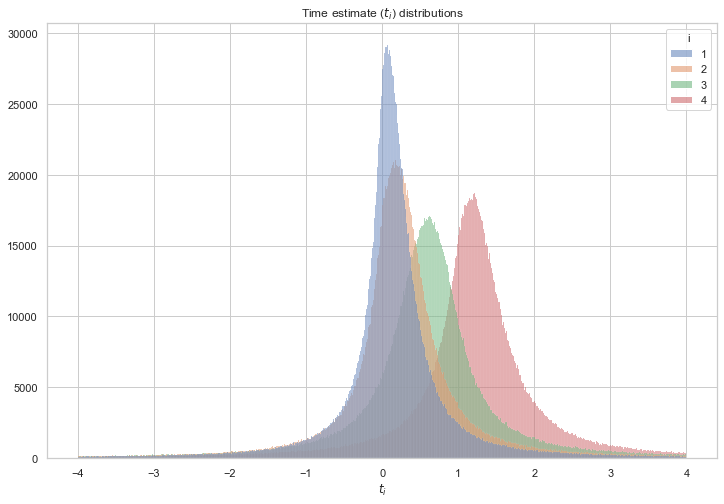

In [57]:
train_resp_filt = train_resp[(np.abs(train_resp["t"]) <= 4)]
train_resp_filt['i'] = pd.Categorical(train_resp_filt['i'])

sns.set(style ="whitegrid")
sns.histplot(x = "t", y = None, hue = "i", data = train_resp_filt)
plt.title(r"Time estimate ($t_i$) distributions")
plt.xlabel(r"$t_i$")
plt.ylabel(None)

plt.show()
##OBSERVATION : Looking deeper into resp variable and impact into the below graph

Now we see what appears to be fairly neat peaks, all with  ti
  positive and in the range 1–2. We also see that the relative ordering of the resp_i appears to be  t1<t2<t3<t4
  which is promising! Also interesting is that resp_4 appears to be for a trade after resp.

#### II.1 Data Cleaning¶
*Missing Value*¶ : Let's replace NaN values with mean value

In [31]:
print(train.shape)
train.info()

(2335474, 138)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2335474 entries, 0 to 2335473
Columns: 138 entries, date to ts_id
dtypes: float16(135), int16(1), int32(1), int8(1)
memory usage: 617.0 MB


In [59]:
# Removing NAN Values as dataframe to big to reshape by replacing NAN by MEAN

replacer = SimpleImputer(missing_values = np.nan, strategy = 'mean') #Unfortunately, the process of replacing missing values with the SimpleImputer generates an array of data of the same size as the original, which significantly increases memory consumption.
replaced_train_df = pd.DataFrame(replacer.fit_transform(train))

replaced_train_df.columns = train.columns
replaced_train_df.index = train.index

print(f"Column With NaN Value : {replaced_train_df.isna().any().sum()}")
del replacer

In [42]:
replaced_train_df = train.copy()
for column in replaced_train_df.columns:
    replaced_train_df[column].fillna(replaced_train_df[column].mean(), inplace=True)

In [43]:
replaced_train_df.head()

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,...,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
0,0,0.049194,0.002514,0.004059,0.015541,0.024353,0.017532,1,-2.541016,0.457031,...,-1.396484,-1.741211,0.984375,1.055664,-0.079468,-2.650391,-1.981445,1.783203,2.867188,87701
1,0,0.180786,-0.000232,0.000292,0.001637,0.002670,0.000906,1,1.434570,-0.801758,...,2.363281,3.087891,-0.680176,-1.452148,-0.482910,0.021545,0.459961,3.931641,-1.233398,131161
2,0,0.808105,0.000639,0.001137,0.002258,0.000157,-0.000690,1,-1.615234,3.070312,...,1.650391,4.535156,-2.318359,0.789551,0.455811,1.509766,-0.890137,-0.652832,1.805664,1964156
3,0,0.000000,0.003162,0.002087,-0.002512,-0.014389,-0.008369,-1,-3.171875,1.500977,...,-0.743652,0.153931,0.180176,-0.653320,0.809082,-3.603516,-1.060547,4.761719,2.455078,1360299
4,0,0.217651,-0.000255,-0.000340,0.001560,0.004780,0.003218,-1,-3.171875,-0.515625,...,-0.277100,1.552734,-0.348145,-0.944824,3.884766,1.967773,-1.015625,0.642578,0.242920,1024723


In [44]:
replaced_train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2335474 entries, 0 to 2335473
Columns: 138 entries, date to ts_id
dtypes: float16(135), int16(1), int32(1), int8(1)
memory usage: 617.0 MB


In [45]:
# Removing Duplicate Value
replaced_train_df.drop_duplicates(keep=False, inplace=True)
print(replaced_train_df.shape)

(2335474, 138)


#### Target Class : ACTION
The objective variable of the competition *feature_0* will be called "action," with a value of 1 indicating a trade and a value of 0 indicating that no trade will be made.

In [46]:
# Creating a new col "action" which contains binary values such as 0 or 1, depending on resp col
replaced_train_df['action'] = (replaced_train_df['resp'] > 0 ).astype('int')
#replaced_train_df.head() #check

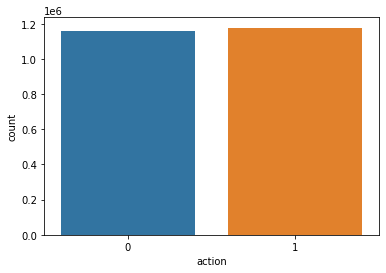

In [47]:
# Checking if our target class is balanced or unbalanced in the training data
sns.countplot(x = "action", data = replaced_train_df)

### III. Prediction with Machine Learning XGBoost method

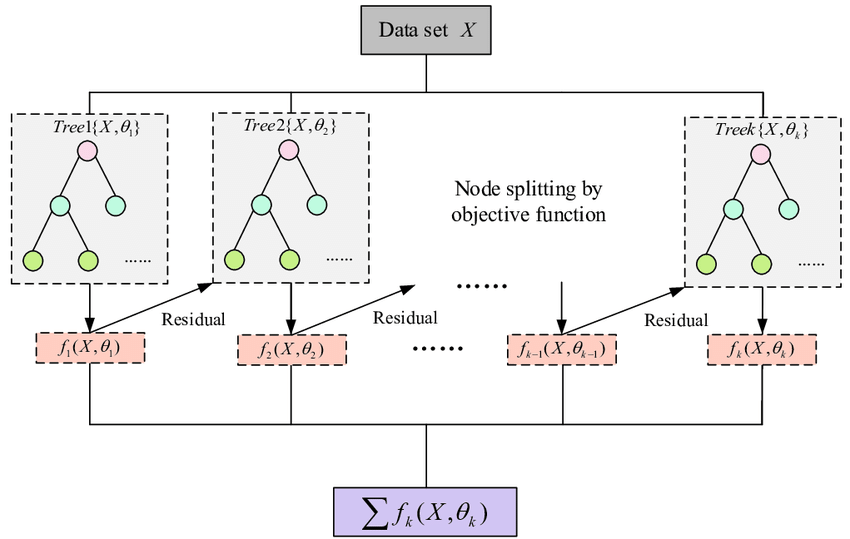
Reference:
https://www.researchgate.net/

Gradient Boosting is a particular kind of boosting algorithm. Boosting consists in assembling several "weak learners" to make a "strong learner", i.e. assembling several algorithms with a low performance to create a much more efficient and satisfactory one. The assembly of "weak learners" into "strong learners" is done by successively calling them to estimate a variable of interest. 

In the context of a regression, the principle is to estimate our outputs by model 1, then to use the residuals of this model as the target variable of model 2 and so on.

In [48]:
X = replaced_train_df.loc[:, replaced_train_df.columns.str.contains('feature')]
y = replaced_train_df.loc[:, 'action']
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)
del replaced_train_df
#del X, y

This code first creates a new dataframe 'X' containing only the columns of 'replaced_train_df' that have the string 'feature' in their column names. It also creates a 'y' series that contains only the 'action' column of 'new_train_df'.

Next, the code uses the train_test_split function from sklearn to split the data into training and testing sets with a test size of 30% and a random state of 42. The training data is assigned to 'x_train' and 'y_train', while the testing data is assigned to 'x_test' and 'y_test'.

Finally, the code deletes the original 'new_train_df' dataframe to save memory, and also comments out a line that would delete 'X' and 'y':

#### III.1. Time Walk

When working with time series data, it is advisable to perform cross-validation using non-overlapping time periods to prevent any data leakage.

In [49]:
from sklearn.metrics import roc_auc_score

from sklearn.model_selection import KFold
from sklearn.model_selection._split import _BaseKFold, indexable, _num_samples
from sklearn.utils.validation import _deprecate_positional_args
class PurgedGroupTimeSeriesSplit(_BaseKFold):
    """Time Series cross-validator variant with non-overlapping groups.
    Allows for a gap in groups to avoid potentially leaking info from
    train into test if the model has windowed or lag features.
    Provides train/test indices to split time series data samples
    that are observed at fixed time intervals according to a
    third-party provided group.
    In each split, test indices must be higher than before, and thus shuffling
    in cross validator is inappropriate.
    This cross-validation object is a variation of :class:`KFold`.
    In the kth split, it returns first k folds as train set and the
    (k+1)th fold as test set.
    The same group will not appear in two different folds (the number of
    distinct groups has to be at least equal to the number of folds).
    Note that unlike standard cross-validation methods, successive
    training sets are supersets of those that come before them.
    Read more in the :ref:`User Guide <cross_validation>`.
    Parameters
    ----------
    n_splits : int, default=5
        Number of splits. Must be at least 2.
    max_train_group_size : int, default=Inf
        Maximum group size for a single training set.
    group_gap : int, default=None
        Gap between train and test
    max_test_group_size : int, default=Inf
        We discard this number of groups from the end of each train split
    """

    @_deprecate_positional_args
    def __init__(self,
                 n_splits = 5,
                 *,
                 max_train_group_size = np.inf,
                 max_test_group_size = np.inf,
                 group_gap = None,
                 verbose = False
                 ):
        super().__init__(n_splits, shuffle = False, random_state = None)
        self.max_train_group_size = max_train_group_size
        self.group_gap = group_gap
        self.max_test_group_size = max_test_group_size
        self.verbose = verbose

    def split(self, X, y = None, groups = None):
        """Generate indices to split data into training and test set.
        Parameters
        ----------
        X : array-like of shape (n_samples, n_features)
            Training data, where n_samples is the number of samples
            and n_features is the number of features.
        y : array-like of shape (n_samples,)
            Always ignored, exists for compatibility.
        groups : array-like of shape (n_samples,)
            Group labels for the samples used while splitting the dataset into
            train/test set.
        Yields
        ------
        train : ndarray
            The training set indices for that split.
        test : ndarray
            The testing set indices for that split.
        """
        if groups is None:
            raise ValueError(
                "The 'groups' parameter should not be None")
        X, y, groups = indexable(X, y, groups)
        n_samples = _num_samples(X)
        n_splits = self.n_splits
        group_gap = self.group_gap
        max_test_group_size = self.max_test_group_size
        max_train_group_size = self.max_train_group_size
        n_folds = n_splits + 1
        group_dict = {}
        u, ind = np.unique(groups, return_index=True)
        unique_groups = u[np.argsort(ind)]
        n_samples = _num_samples(X)
        n_groups = _num_samples(unique_groups)
        for idx in np.arange(n_samples):
            if (groups[idx] in group_dict):
                group_dict[groups[idx]].append(idx)
            else:
                group_dict[groups[idx]] = [idx]
        if n_folds > n_groups:
            raise ValueError(
                ("Cannot have number of folds={0} greater than"
                 " the number of groups={1}").format(n_folds,
                                                     n_groups))

        group_test_size = min(n_groups // n_folds, max_test_group_size)
        group_test_starts = range(n_groups - n_splits * group_test_size,
                                  n_groups, group_test_size)
        for group_test_start in group_test_starts:
            train_array = []
            test_array = []

            group_st = max(0, group_test_start - group_gap - max_train_group_size)
            for train_group_idx in unique_groups[group_st:(group_test_start - group_gap)]:
                train_array_tmp = group_dict[train_group_idx]
                
                train_array = np.sort(np.unique(
                                      np.concatenate((train_array,
                                                      train_array_tmp)),
                                      axis=None), axis=None)

            train_end = train_array.size
 
            for test_group_idx in unique_groups[group_test_start:
                                                group_test_start +
                                                group_test_size]:
                test_array_tmp = group_dict[test_group_idx]
                test_array = np.sort(np.unique(
                                              np.concatenate((test_array,
                                                              test_array_tmp)),
                                     axis=None), axis=None)

            test_array  = test_array[group_gap:]
            
            
            if self.verbose > 0:
                    pass
                    
            yield [int(i) for i in train_array], [int(i) for i in test_array]

In [50]:
def plot_cv_indices(cv, X, y, group, ax, n_splits, lw=10):
    """Create a sample plot for indices of a cross-validation object."""
    
    cmap_cv = plt.cm.coolwarm

    jet = plt.cm.get_cmap('jet', 256)
    seq = np.linspace(0, 1, 256)
    _ = np.random.shuffle(seq)   # inplace
    cmap_data = ListedColormap(jet(seq))

    # Generate the training/testing visualizations for each CV split
    for ii, (tr, tt) in enumerate(cv.split(X=X, y=y, groups=group)):
        # Fill in indices with the training/test groups
        indices = np.array([np.nan] * len(X))
        indices[tt] = 1
        indices[tr] = 0

        # Visualize the results
        ax.scatter(range(len(indices)), [ii + .5] * len(indices),
                   c=indices, marker='_', lw=lw, cmap=cmap_cv,
                   vmin=-.2, vmax=1.2)

    # Plot the data classes and groups at the end
    ax.scatter(range(len(X)), [ii + 1.5] * len(X),
               c=y, marker='_', lw=lw, cmap=plt.cm.Set3)

    ax.scatter(range(len(X)), [ii + 2.5] * len(X),
               c=group, marker='_', lw=lw, cmap=cmap_data)

    # Formatting
    yticklabels = list(range(n_splits)) + ['target', 'day']
    ax.set(yticks=np.arange(n_splits+2) + .5, yticklabels=yticklabels,
           xlabel='Sample index', ylabel="CV iteration",
           ylim=[n_splits+2.2, -.2], xlim=[0, len(y)])
    ax.set_title('{}'.format(type(cv).__name__), fontsize=15)
    return ax

In [51]:
#train['action']=train['resp_1']+train['resp_2']+train['resp_3']+train['resp_4']+train['resp']
train['action']=train['resp']
train['action'] = (train['action'] > 0 ).astype('int')

Using an average of the return over time is more stable, and it also provides a measure of market trend.

#### III.2. Cross Validation

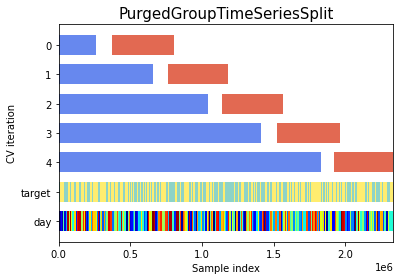

In [52]:
n_splits = 5 # Sets the number of splits or folds for cross-validation to 5
group_gap = 31 # Sets the gap between different groups in the time series, i.e., the number of consecutive samples that should be included in the same group
cv = PurgedGroupTimeSeriesSplit(n_splits = n_splits, group_gap = group_gap) # Creates an instance of the PurgedGroupTimeSeriesSplit class for cross-validation
fig, ax = plt.subplots()
# Plots the cross-validation indices on the axes created in the previous step:
plot_cv_indices(cv, train[features].values, train['action'].values, train['date'].values, ax, 5, lw = 20)
plt.show()

#### III.3. Reshaping our Train dataset

In [53]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2335474 entries, 0 to 2335473
Columns: 139 entries, date to action
dtypes: float16(135), int16(1), int32(2), int8(1)
memory usage: 625.9 MB


In [57]:
features = pd.read_csv('C:/Users/ahwid/Desktop/Dauphine Executive Master IASD/Machine Learning/Machine Learning devoir Jane Street Market Prediction/features.csv')

In [61]:
print('train shape is {}'.format(train.shape))
print('features shape is {}'.format(features.shape))
print('example_test shape is {}'.format(example_test.shape))
print('sample_prediction_df shape is {}'.format(sample_prediction_df.shape))

train shape is (2335474, 139)
features shape is (130, 30)
example_test shape is (15219, 133)
sample_prediction_df shape is (15219, 2)


In [62]:
missing_values_count = train.isnull().sum()
print (missing_values_count)
total_cells = np.product(train.shape)
total_missing = missing_values_count.sum()
print ("% of missing data = ",(total_missing/total_cells) * 100)

date              0
weight            0
resp_1            0
resp_2            0
resp_3            0
               ... 
feature_127    8540
feature_128    1803
feature_129    1842
ts_id             0
action            0
Length: 139, dtype: int64
% of missing data =  2.0352068410397646


In [63]:
train = reduce_mem_usage(train)
features = [c for c in train.columns if 'feature' in c]

Mem. usage decreased to 619.18 Mb (1.1% reduction)


In [64]:
def fillna_npwhere(array, values):
    if np.isnan(array.sum()):
        array = np.where(np.isnan(array), values, array)
    return array

In [65]:
%%time
train = train.fillna(train.mean())

Wall time: 2.63 s


In [66]:
%%time
train['action'] = ((train['resp'] > 0) & (train['weight'] > 0)).astype('int')

Wall time: 46.1 ms


Here we will drop resp variables as they are not present in the test set. These variables are not included in the test set. Trades with weight = 0 were intentionally included in the dataset for completeness, although such trades will not contribute towards the scoring evaluation.

In [68]:
%%time
#train = train.drop(labels='date',axis=1)
train = train.drop(labels='weight',axis=1)
train = train.drop(labels='resp_1',axis=1)
train = train.drop(labels='resp_2',axis=1)
train = train.drop(labels='resp_3',axis=1)
train = train.drop(labels='resp_4',axis=1)
train = train.drop(labels='resp',axis=1)

KeyError: "['weight'] not found in axis"

In [70]:
X = train.drop(labels=['action','ts_id','date'],axis=1)
y = train['action']

In [71]:
list(train.drop(labels=['action','ts_id','date'],axis=1).columns)

['feature_0',
 'feature_1',
 'feature_2',
 'feature_3',
 'feature_4',
 'feature_5',
 'feature_6',
 'feature_7',
 'feature_8',
 'feature_9',
 'feature_10',
 'feature_11',
 'feature_12',
 'feature_13',
 'feature_14',
 'feature_15',
 'feature_16',
 'feature_17',
 'feature_18',
 'feature_19',
 'feature_20',
 'feature_21',
 'feature_22',
 'feature_23',
 'feature_24',
 'feature_25',
 'feature_26',
 'feature_27',
 'feature_28',
 'feature_29',
 'feature_30',
 'feature_31',
 'feature_32',
 'feature_33',
 'feature_34',
 'feature_35',
 'feature_36',
 'feature_37',
 'feature_38',
 'feature_39',
 'feature_40',
 'feature_41',
 'feature_42',
 'feature_43',
 'feature_44',
 'feature_45',
 'feature_46',
 'feature_47',
 'feature_48',
 'feature_49',
 'feature_50',
 'feature_51',
 'feature_52',
 'feature_53',
 'feature_54',
 'feature_55',
 'feature_56',
 'feature_57',
 'feature_58',
 'feature_59',
 'feature_60',
 'feature_61',
 'feature_62',
 'feature_63',
 'feature_64',
 'feature_65',
 'feature_66',
 'fea

In [72]:
%%time
X = StandardScaler().fit_transform(X)

Wall time: 9.4 s


In [73]:
from sklearn.metrics import log_loss

In [74]:
def objective(trial, X, y):
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 400, 600),
        'max_depth': trial.suggest_int('max_depth', 5, 10), # Reduce max_depth to reduce memory usage
        'learning_rate': trial.suggest_uniform('learning_rate', 0.01, .1),
        'subsample': trial.suggest_uniform('subsample', 0.50, 1),
        'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.50, 1),
        'gamma': trial.suggest_int('gamma', 0, 10),
        'tree_method' : 'gpu_hist',
        'objective': 'binary:logistic',
         'missing': -999
    }
    gkf = PurgedGroupTimeSeriesSplit(n_splits = n_splits, group_gap = group_gap)
    accuracy = np.empty(5)
    #for idx, (train_idx, test_idx) in enumerate(cv.split(X, y)):
    for idx, (train_idx, test_idx) in enumerate(gkf.split(train['action'].values, train['action'].values, train['date'].values)):    
        dtrain = xgb.DMatrix( X.iloc[train_idx], label = y[train_idx])
        dtest  = xgb.DMatrix(X.iloc[test_idx], label = y[test_idx])
        
        bst = xgb.train(params, dtrain)
        y_preds_test = bst.predict(dtest)
     
        y_preds_train = bst.predict(dtrain)
        print(y_preds_train)
        accuracy_train = accuracy_score(np.rint(y_preds_train), y[train_idx])
        print('train:',accuracy_train)
       
        accuracy_test = accuracy_score(np.rint(y_preds_test), y[test_idx])
        print('test:',accuracy_test)
        accuracy[idx] = accuracy_test
        # cv_scores[idx] = log_loss(  y_preds_test , y[test_idx])

    return np.mean(accuracy)

In [76]:
study = optuna.create_study(direction = 'maximize')

[I 2023-03-05 20:22:36,822] A new study created in memory with name: no-name-f8d801c6-7efe-4d23-8198-4952474937af


In [79]:
func = lambda trial: objective(trial, train[features], train['action'] )

In [80]:
study.optimize(func, n_trials = 20)

[08:01:48] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.46899596 0.46392718 0.47563592 ... 0.46890494 0.4680961  0.46019343]
train: 0.5800766251369055
test: 0.5827009886024755
[08:02:02] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4703324  0.46758837 0.47157976 ... 0.46634728 0.4691294  0.46843654]
train: 0.5813105993048706
test: 0.5817336788080598
[08:02:26] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4692801  0.47188357 0.46688643 ... 0.46898705 0.4699531  0.4684806 ]
train: 0.5815549117011329
test: 0.582043092

[I 2023-03-06 08:03:59,874] Trial 12 finished with value: 0.5822733765218725 and parameters: {'n_estimators': 599, 'max_depth': 5, 'learning_rate': 0.04829595246473909, 'subsample': 0.5336533430361383, 'colsample_bytree': 0.9815835949954936, 'gamma': 10}. Best is trial 9 with value: 0.582277980374021.


[08:04:11] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4730236  0.47181466 0.47811112 ... 0.47239664 0.471736   0.4663875 ]
train: 0.5801647482406852
test: 0.5827392867355693
[08:04:26] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47741482 0.47270602 0.47438946 ... 0.4715505  0.47470763 0.4756844 ]
train: 0.5813373835280179
test: 0.5817205794124659
[08:04:50] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47409454 0.4779582  0.47492534 ... 0.47451732 0.47326693 0.47258443]
train: 0.58155981746629
test: 0.58204571039

[I 2023-03-06 08:06:21,737] Trial 13 finished with value: 0.5822794424362998 and parameters: {'n_estimators': 565, 'max_depth': 6, 'learning_rate': 0.0371611413672583, 'subsample': 0.6191952331264087, 'colsample_bytree': 0.8729528404011139, 'gamma': 8}. Best is trial 13 with value: 0.5822794424362998.


[08:06:33] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47148487 0.47177586 0.4741251  ... 0.46908996 0.47275713 0.47289187]
train: 0.5801018031665569
test: 0.582716307855713
[08:06:47] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47102126 0.46889916 0.4682903  ... 0.47084418 0.47351575 0.4721799 ]
train: 0.5813326569004037
test: 0.5817284390498222
[08:07:12] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47079203 0.47138482 0.46948776 ... 0.47214904 0.47164208 0.4708687 ]
train: 0.581578459373887
test: 0.58203785637

[I 2023-03-06 08:08:46,625] Trial 14 finished with value: 0.5822743452182126 and parameters: {'n_estimators': 589, 'max_depth': 6, 'learning_rate': 0.04353309070697797, 'subsample': 0.6355644382879643, 'colsample_bytree': 0.8567814546654442, 'gamma': 8}. Best is trial 13 with value: 0.5822794424362998.


[08:08:57] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.46859857 0.46626908 0.46699533 ... 0.46281126 0.45723945 0.4577814 ]
train: 0.5804123321989232
test: 0.5826065198741779
[08:09:12] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.46726596 0.4653305  0.46180803 ... 0.4685392  0.46720594 0.4652056 ]
train: 0.5813515634108606
test: 0.5817205794124659
[08:09:37] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.46338025 0.4638668  0.46330178 ... 0.4638922  0.46493822 0.45825934]
train: 0.5815990635875468
test: 0.582032620

[I 2023-03-06 08:11:07,879] Trial 15 finished with value: 0.582247758229385 and parameters: {'n_estimators': 570, 'max_depth': 6, 'learning_rate': 0.05891628644971314, 'subsample': 0.7554825722369495, 'colsample_bytree': 0.8747846063210785, 'gamma': 0}. Best is trial 13 with value: 0.5822794424362998.


[08:11:19] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4781455  0.4743665  0.47728258 ... 0.4718311  0.47835684 0.47325164]
train: 0.5802234969765383
test: 0.5826958821847298
[08:11:32] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47735733 0.47070405 0.473062   ... 0.4708406  0.47313094 0.47347236]
train: 0.581340534613094
test: 0.5817153396542284
[08:11:58] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47472215 0.47385967 0.4730307  ... 0.47301206 0.4741085  0.47237653]
train: 0.5815578551602272
test: 0.5820430923

[I 2023-03-06 08:13:33,392] Trial 16 finished with value: 0.5822686874075571 and parameters: {'n_estimators': 512, 'max_depth': 6, 'learning_rate': 0.038951117784802404, 'subsample': 0.6189439380950704, 'colsample_bytree': 0.7753428178386732, 'gamma': 8}. Best is trial 13 with value: 0.5822794424362998.


[08:13:44] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47416818 0.4749619  0.47704047 ... 0.47507864 0.46980453 0.47829002]
train: 0.5812390108391418
test: 0.582517157563626
[08:14:00] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47864172 0.4726771  0.4742351  ... 0.47841892 0.47609282 0.47542688]
train: 0.5814224628250738
test: 0.5816839011048031
[08:14:25] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47420314 0.4763833  0.47424453 ... 0.47534236 0.47593233 0.47547588]
train: 0.581597101281484
test: 0.58203785637

[I 2023-03-06 08:15:59,620] Trial 17 finished with value: 0.5822230506472817 and parameters: {'n_estimators': 563, 'max_depth': 7, 'learning_rate': 0.035214648710327236, 'subsample': 0.7797591019643315, 'colsample_bytree': 0.8775221370822234, 'gamma': 7}. Best is trial 13 with value: 0.5822794424362998.


[08:16:11] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.46470875 0.4677229  0.46736255 ... 0.46211413 0.46260995 0.4596288 ]
train: 0.5800724287986303
test: 0.5827035418113485
[08:16:26] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.46441844 0.4614397  0.45430008 ... 0.46457943 0.46860728 0.4636002 ]
train: 0.5813074482197945
test: 0.5817258191707034
[08:16:50] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.46226048 0.46424827 0.46299723 ... 0.4618278  0.46359918 0.46286342]
train: 0.5815558928541643
test: 0.582043092

[I 2023-03-06 08:18:26,473] Trial 18 finished with value: 0.5822718126705785 and parameters: {'n_estimators': 477, 'max_depth': 5, 'learning_rate': 0.05906011883697903, 'subsample': 0.670463133641529, 'colsample_bytree': 0.9948522278105327, 'gamma': 9}. Best is trial 13 with value: 0.5822794424362998.


[08:18:38] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.49407518 0.49202856 0.49616218 ... 0.49171817 0.49273545 0.49500656]
train: 0.5822922917462222
test: 0.5824175824175825
[08:18:53] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.49269873 0.49072492 0.49206927 ... 0.49234664 0.49240583 0.49257132]
train: 0.5815595350258862
test: 0.5817231992915847
[08:19:18] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4919225  0.49243793 0.4914483  ... 0.4918879  0.49228546 0.49173167]
train: 0.5816736312179347
test: 0.582024766

[I 2023-03-06 08:20:56,378] Trial 19 finished with value: 0.5822033515928059 and parameters: {'n_estimators': 581, 'max_depth': 8, 'learning_rate': 0.010140135061736825, 'subsample': 0.7830457140137618, 'colsample_bytree': 0.7292166562742489, 'gamma': 5}. Best is trial 13 with value: 0.5822794424362998.


[08:21:07] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4785501  0.48455447 0.47691685 ... 0.46729037 0.47895044 0.47268146]
train: 0.5802738530358409
test: 0.582660137260509
[08:21:22] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47544548 0.47471645 0.47617418 ... 0.47436962 0.47732556 0.47451612]
train: 0.5813137503899468
test: 0.5817231992915847
[08:21:47] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47558296 0.479027   0.47461203 ... 0.47507378 0.47594678 0.47495565]
train: 0.5815549117011329
test: 0.5820430923

[I 2023-03-06 08:23:21,384] Trial 20 finished with value: 0.5822631103501842 and parameters: {'n_estimators': 533, 'max_depth': 6, 'learning_rate': 0.03459932929727097, 'subsample': 0.5568992346201691, 'colsample_bytree': 0.8144162366184673, 'gamma': 5}. Best is trial 13 with value: 0.5822794424362998.


[08:23:31] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4682995  0.4789701  0.46917915 ... 0.46615103 0.46610492 0.4687978 ]
train: 0.5814991838122054
test: 0.5824558805506761
[08:23:46] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47013977 0.4647676  0.4597846  ... 0.4683298  0.46775386 0.4652519 ]
train: 0.5815059665795916
test: 0.5817336788080598
[08:24:11] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4673919  0.46470028 0.46404395 ... 0.47172907 0.46381333 0.46464726]
train: 0.5816589139224634
test: 0.582016912

[I 2023-03-06 08:25:48,934] Trial 21 finished with value: 0.5822206265950053 and parameters: {'n_estimators': 493, 'max_depth': 8, 'learning_rate': 0.05128854264550264, 'subsample': 0.6722813343338508, 'colsample_bytree': 0.9024157643930212, 'gamma': 9}. Best is trial 13 with value: 0.5822794424362998.


[08:26:00] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47016823 0.46978    0.4753374  ... 0.4703484  0.46896654 0.4714799 ]
train: 0.5801773372555108
test: 0.5827035418113485
[08:26:12] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47611028 0.46713883 0.4684524  ... 0.47126547 0.47214442 0.47279763]
train: 0.5813578655810128
test: 0.5817127197751095
[08:26:36] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47107035 0.47230956 0.47000974 ... 0.471879   0.47212937 0.47501162]
train: 0.5815647232314471
test: 0.582058800

[I 2023-03-06 08:27:44,034] Trial 22 finished with value: 0.5822728281459322 and parameters: {'n_estimators': 600, 'max_depth': 6, 'learning_rate': 0.04178161539214067, 'subsample': 0.6167623534374588, 'colsample_bytree': 0.8393209567058434, 'gamma': 8}. Best is trial 13 with value: 0.5822794424362998.


[08:27:49] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47019526 0.4703436  0.47317344 ... 0.47021857 0.47021794 0.4683627 ]
train: 0.5800556434455294
test: 0.5827239674823318
[08:27:56] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4726356  0.46782774 0.46902862 ... 0.47051585 0.4731333  0.4723244 ]
train: 0.5813232036451752
test: 0.5817284390498222
[08:28:09] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47118413 0.47393677 0.47035077 ... 0.47206467 0.47183314 0.4712772 ]
train: 0.5815578551602272
test: 0.582045710

[I 2023-03-06 08:28:59,721] Trial 23 finished with value: 0.5822779505131236 and parameters: {'n_estimators': 581, 'max_depth': 5, 'learning_rate': 0.04192253250668562, 'subsample': 0.6183623581344234, 'colsample_bytree': 0.8383127560356902, 'gamma': 7}. Best is trial 13 with value: 0.5822794424362998.


[08:29:05] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.48207322 0.48145092 0.4811466  ... 0.48106116 0.4772775  0.48059225]
train: 0.5800262690776029
test: 0.5827214142734589
[08:29:12] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.48189747 0.4794971  0.48065597 ... 0.4810754  0.48110858 0.48083824]
train: 0.5813169014750229
test: 0.5817362986871786
[08:29:25] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.48131    0.48155802 0.482366   ... 0.48175722 0.48183995 0.48098537]
train: 0.5815539305481016
test: 0.582043092

[I 2023-03-06 08:30:22,462] Trial 24 finished with value: 0.5822779856318929 and parameters: {'n_estimators': 554, 'max_depth': 5, 'learning_rate': 0.02588469392422721, 'subsample': 0.5798767488873202, 'colsample_bytree': 0.8918744313332444, 'gamma': 7}. Best is trial 13 with value: 0.5822794424362998.


[08:30:27] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.49026668 0.485321   0.48407894 ... 0.4832886  0.47978628 0.48507312]
train: 0.5800430544307038
test: 0.5827137546468402
[08:30:35] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.48418826 0.48302364 0.48172888 ... 0.4817742  0.48323748 0.4838708 ]
train: 0.5813137503899468
test: 0.5817310589289411
[08:30:48] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.48274502 0.48306817 0.48218715 ... 0.4831563  0.48343575 0.48249635]
train: 0.5815539305481016
test: 0.582043092

[I 2023-03-06 08:31:51,237] Trial 25 finished with value: 0.5822754057549216 and parameters: {'n_estimators': 553, 'max_depth': 5, 'learning_rate': 0.02347240249998539, 'subsample': 0.5853273846844728, 'colsample_bytree': 0.8998245359504965, 'gamma': 7}. Best is trial 13 with value: 0.5822794424362998.


[08:31:56] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4810984  0.48087642 0.48253962 ... 0.47785228 0.47974116 0.47829488]
train: 0.5800514471072542
test: 0.5827239674823318
[08:32:05] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4818244  0.48055404 0.4830013  ... 0.48115295 0.4801514  0.48123193]
train: 0.5813090237623325
test: 0.5817310589289411
[08:32:18] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.48076507 0.48224652 0.47908995 ... 0.48067293 0.48178902 0.48061016]
train: 0.5815549117011329
test: 0.582045710

[I 2023-03-06 08:33:10,697] Trial 26 finished with value: 0.58227797192335 and parameters: {'n_estimators': 519, 'max_depth': 5, 'learning_rate': 0.02662867386267491, 'subsample': 0.5287028391378862, 'colsample_bytree': 0.8935793785651888, 'gamma': 10}. Best is trial 13 with value: 0.5822794424362998.


[08:33:16] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47490048 0.47109586 0.48059297 ... 0.47045785 0.47452116 0.478364  ]
train: 0.5801437665493091
test: 0.5827035418113485
[08:33:24] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4774633  0.4786567  0.47731888 ... 0.47599724 0.4759535  0.47550213]
train: 0.5813137503899468
test: 0.5817231992915847
[08:33:37] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4753652  0.4768306  0.47376922 ... 0.47541147 0.47573754 0.4748056 ]
train: 0.5815539305481016
test: 0.582043092

[I 2023-03-06 08:34:30,947] Trial 27 finished with value: 0.5822717912603521 and parameters: {'n_estimators': 536, 'max_depth': 6, 'learning_rate': 0.03507330436932581, 'subsample': 0.506302871640299, 'colsample_bytree': 0.7929053224015584, 'gamma': 9}. Best is trial 13 with value: 0.5822794424362998.


test: 0.582244723149107
[08:34:36] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.48521066 0.48510835 0.48772132 ... 0.48552963 0.48721495 0.4860877 ]
train: 0.5807648246140418
test: 0.5825273703991176
[08:34:45] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4856104  0.4845898  0.47992253 ... 0.48724756 0.48164928 0.48489922]
train: 0.5813862253466981
test: 0.5817179595333472
[08:34:58] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.48525742 0.48565674 0.4849077  ... 0.48426753 0.48633993 0.48432758]
train: 0.5816530270

[I 2023-03-06 08:35:55,741] Trial 28 finished with value: 0.582229926516594 and parameters: {'n_estimators': 570, 'max_depth': 7, 'learning_rate': 0.019863949365864074, 'subsample': 0.6641584149882152, 'colsample_bytree': 0.9652223843030114, 'gamma': 7}. Best is trial 13 with value: 0.5822794424362998.


[08:36:01] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47906673 0.4843815  0.47742102 ... 0.47723746 0.4762682  0.47603324]
train: 0.5800514471072542
test: 0.582716307855713
[08:36:10] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4807703  0.4783679  0.48099768 ... 0.47846836 0.47776362 0.48062283]
train: 0.5813105993048706
test: 0.5817310589289411
[08:36:24] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4781576  0.4830131  0.4771794  ... 0.47660792 0.4796479  0.4800111 ]
train: 0.5815568740071958
test: 0.5820457103

[I 2023-03-06 08:37:15,342] Trial 29 finished with value: 0.5822764399980264 and parameters: {'n_estimators': 521, 'max_depth': 5, 'learning_rate': 0.030408695353337144, 'subsample': 0.5635137607309342, 'colsample_bytree': 0.9165088814051424, 'gamma': 4}. Best is trial 13 with value: 0.5822794424362998.


[08:37:21] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4764745  0.47745624 0.47583777 ... 0.47457948 0.4753189  0.47730386]
train: 0.5800640361220799
test: 0.5827035418113485
[08:37:29] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47833484 0.47630697 0.47676295 ... 0.47874522 0.47906697 0.4764797 ]


[W 2023-03-06 08:37:31,713] Trial 30 failed with parameters: {'n_estimators': 549, 'max_depth': 5, 'learning_rate': 0.03294460883316585, 'subsample': 0.5086603241605133, 'colsample_bytree': 0.9998603319185468, 'gamma': 9} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "C:\Users\ahwid\anaconda3\lib\site-packages\optuna\study\_optimize.py", line 200, in _run_trial
    value_or_values = func(trial)
  File "<ipython-input-79-2d25781a5649>", line 1, in <lambda>
    func = lambda trial: objective(trial, train[features], train['action'] )
  File "<ipython-input-74-2a4871d2db2c>", line 27, in objective
    accuracy_train=accuracy_score(np.rint(y_preds_train), y[train_idx])
  File "C:\Users\ahwid\anaconda3\lib\site-packages\pandas\core\series.py", line 910, in __getitem__
    return self._get_with(key)
  File "C:\Users\ahwid\anaconda3\lib\site-packages\pandas\core\series.py", line 939, in _get_with
    key_type = lib.infer_dtype(key, skipna=False)

KeyboardInterrupt: 

In [81]:
print(f"\tBest value (accuracy): {study.best_value:.5f}")
print(f"\tBest params:")

for key, value in study.best_params.items():
    print(f"\t\t{key}: {value}")

	Best value (accuracy): 0.58228
	Best params:
		n_estimators: 565
		max_depth: 6
		learning_rate: 0.0371611413672583
		subsample: 0.6191952331264087
		colsample_bytree: 0.8729528404011139
		gamma: 8


## *Here, our best value (accuracy) scores 0.58228*

In [82]:
# Creates a DMatrix object from the training data and trains an XGBoost model, by efficiently storing and manipulating data / target variable "action"
dtrain = xgb.DMatrix( train[features], label = train['action'] )
bst = xgb.train(study.best_params, dtrain) # Study.best_params should be a dictionary that contains the best hyperparameters found during hyperparameter tuning.

[08:39:29] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "n_estimators" } are not used.



In [84]:
#pip install shap # SHapley Additive exPlanations


  Attempting uninstall: packaging
    Found existing installation: packaging 20.4
    Uninstalling packaging-20.4:
      Successfully uninstalled packaging-20.4


In [85]:
#SHAP can help you to understand how individual features contribute to the output of the model, and can be used to diagnose issues with the model or to identify areas for improvement.
import shap 

In [86]:
shap.initjs() # loads the necessary JavaScript libraries for rendering SHAP plots 

In [87]:
explainer = shap.TreeExplainer(bst) # Creates a tree explainer object from the trained XGBoost model bst, used to compute SHAP values for the model
shap_values = explainer.shap_values(dtrain) # Computes the SHAP values for the training data using the TreeExplainer object.

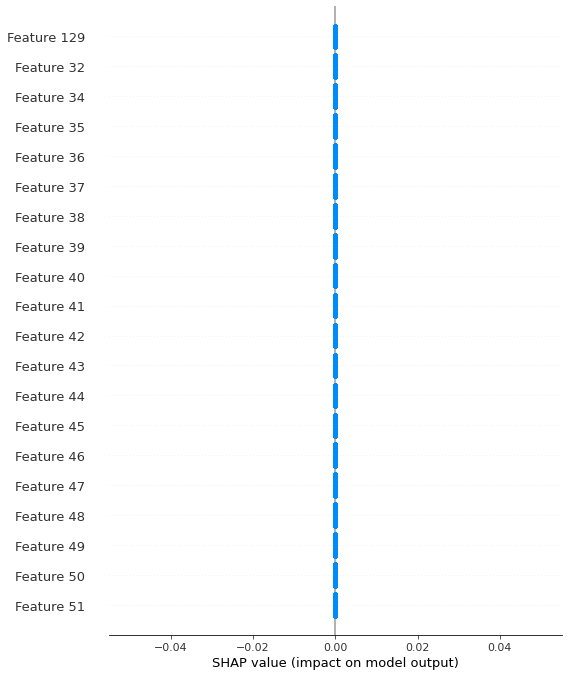

In [88]:
shap.summary_plot(shap_values)

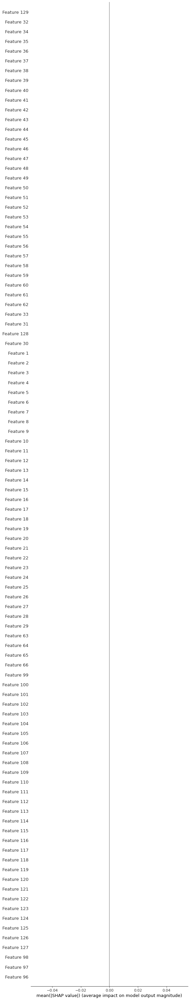

In [89]:
# SHAP values with additional customization options : sets maximum number of features to display in the plot.
shap.summary_plot(shap_values, max_display = 100, show = False, plot_type = 'bar')

Perhaps we can get a better result, using only the most important features according to shap?

In [90]:
selected=['feature_129','feature_32','feature_34','feature_35','feature_36',
          'feature_37','feature_38','feature_39','feature_40','feature_41',
          'feature_42','feature_43','feature_44','feature_45','feature_46',
         'feature_47','feature_48']

In [91]:
# Manages the optimization process, including the search space of hyperparameters, the optimization algorithm, and the stopping criteria.
study_bis = optuna.create_study(direction = 'maximize')

[I 2023-03-06 08:54:04,688] A new study created in memory with name: no-name-7a9e1231-1bea-4cb6-ab3f-a1720d82d46a


In [92]:
# Creates a function that can be passed as an argument to Optuna's optimization functions. 
func2 = lambda trial: objective(trial, train[selected], train['action'] )

In [94]:
study_bis.optimize(func2, n_trials = 5)

[08:58:55] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.46584806 0.45996752 0.46301314 ... 0.46291935 0.46479082 0.4620224 ]
train: 0.5810291939253807
test: 0.5824073695820907
[08:58:59] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.46906623 0.46103925 0.46236297 ... 0.4616369  0.46329632 0.46191147]
train: 0.5815500817706577
test: 0.5817153396542284
[08:59:07] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4634646  0.46323434 0.46116978 ... 0.4597458  0.46246356 0.46336368]
train: 0.581627517025458
test: 0.5820326203

[I 2023-03-06 08:59:44,013] Trial 1 finished with value: 0.5822023218525254 and parameters: {'n_estimators': 595, 'max_depth': 6, 'learning_rate': 0.059335315979821425, 'subsample': 0.9700347028404823, 'colsample_bytree': 0.926097600235614, 'gamma': 1}. Best is trial 1 with value: 0.5822023218525254.


test: 0.5822344954550684
[08:59:47] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4784931  0.469779   0.47316852 ... 0.47190532 0.47285882 0.47626424]
train: 0.5841135025576681
test: 0.5821826872012745
[08:59:52] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4806812  0.47518197 0.4734283  ... 0.476314   0.4745363  0.472253  ]
train: 0.5820794640634502
test: 0.5816341234015463
[08:59:59] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.47479594 0.4729099  0.47457874 ... 0.47393703 0.47070575 0.47527933]
train: 0.582124961

[I 2023-03-06 09:00:34,542] Trial 2 finished with value: 0.5821194833935739 and parameters: {'n_estimators': 561, 'max_depth': 9, 'learning_rate': 0.037822472775241964, 'subsample': 0.8825915483352418, 'colsample_bytree': 0.7124948677731706, 'gamma': 0}. Best is trial 1 with value: 0.5822023218525254.


test: 0.5822089262199721
[09:00:38] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.45450145 0.45265418 0.45397696 ... 0.45466566 0.4569322  0.4601167 ]
train: 0.5802654603592905
test: 0.5827035418113485
[09:00:42] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4610161  0.45507407 0.45379013 ... 0.46064657 0.45500472 0.45345554]
train: 0.5813578655810128
test: 0.5817100998959908
[09:00:50] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.45542836 0.45479065 0.45621264 ... 0.45469618 0.45513472 0.4620287 ]
train: 0.581606912

[I 2023-03-06 09:01:26,526] Trial 3 finished with value: 0.5822718579166619 and parameters: {'n_estimators': 497, 'max_depth': 6, 'learning_rate': 0.07706248473338351, 'subsample': 0.9028652040701675, 'colsample_bytree': 0.9677919654485998, 'gamma': 5}. Best is trial 3 with value: 0.5822718579166619.


test: 0.5822523939196359
[09:01:30] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.45368028 0.452971   0.4513703  ... 0.45723018 0.45920232 0.45179546]
train: 0.5801479628875843
test: 0.5827009886024755
[09:01:34] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4549474  0.45214352 0.45292434 ... 0.46747547 0.4523212  0.45248535]
train: 0.5813263547302514
test: 0.5817231992915847
[09:01:42] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.45517018 0.45181614 0.45471963 ... 0.4528548  0.4533529  0.45421708]
train: 0.581557855

[I 2023-03-06 09:02:24,132] Trial 4 finished with value: 0.582268212310366 and parameters: {'n_estimators': 476, 'max_depth': 5, 'learning_rate': 0.08127838248765376, 'subsample': 0.8397338502801763, 'colsample_bytree': 0.9714566697747355, 'gamma': 3}. Best is trial 3 with value: 0.5822718579166619.


test: 0.5822293816080492
[09:02:27] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.45230404 0.45705354 0.45129615 ... 0.45888627 0.45635247 0.47089794]
train: 0.58177614213837
test: 0.582343539360268
[09:02:32] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.4680501  0.44717187 0.45605192 ... 0.45635995 0.45967716 0.45342946]
train: 0.5816320099826375
test: 0.581649842676259
[09:02:41] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-03de431ba26204c4d-1/xgboost/xgboost-ci-windows/src/learner.cc:767: 
Parameters: { "missing", "n_estimators" } are not used.

[0.46600106 0.45363072 0.4546658  ... 0.45618966 0.45947242 0.45851234]
train: 0.5816765746770

[I 2023-03-06 09:03:26,609] Trial 5 finished with value: 0.5821676976690966 and parameters: {'n_estimators': 439, 'max_depth': 8, 'learning_rate': 0.07504807078438702, 'subsample': 0.5547019259662895, 'colsample_bytree': 0.7531356309695256, 'gamma': 4}. Best is trial 3 with value: 0.5822718579166619.


test: 0.5822575077666552


In [95]:
print(f"\tBest value (accuracy): {study_bis.best_value:.5f}")
print(f"\tBest params:")

for key, value in study_bis.best_params.items():
    print(f"\t\t{key}: {value}")

	Best value (accuracy): 0.58227
	Best params:
		n_estimators: 497
		max_depth: 6
		learning_rate: 0.07706248473338351
		subsample: 0.9028652040701675
		colsample_bytree: 0.9677919654485998
		gamma: 5


#### III.4. Saving result

In [96]:
train[features].shape, example_test[train.drop(labels=['action','ts_id','date'],axis=1).columns].shape

((2335474, 130), (15219, 130))

In [97]:
m = train[features].mean()

In [98]:
test = StandardScaler().fit_transform(pd.DataFrame(fillna_npwhere(example_test[train.drop(labels=['action','ts_id','date'],axis=1).columns].values,m.values),columns=features))

In [99]:
test = pd.DataFrame(test,columns=train[features].columns)

In [100]:
dtest = xgb.DMatrix(test)

In [102]:
example_sample_submission = pd.read_csv('C:/Users/ahwid/Desktop/Dauphine Executive Master IASD/Machine Learning/Machine Learning devoir Jane Street Market Prediction/example_sample_submission.csv')

In [105]:
example_sample_submission.action = np.rint( bst.predict(dtest))

In [106]:
#pip install lightgbm

Note: you may need to restart the kernel to use updated packages.Requirement already satisfied: wheel in c:\users\ahwid\anaconda3\lib\site-packages (from lightgbm) (0.36.2)



In [107]:
from optuna.integration import LightGBMPruningCallback
import lightgbm as lgb

In [108]:
def objective2(trial, X, y):
    param_grid = {
        "device_type": trial.suggest_categorical("device_type", ['gpu']),
        #"n_estimators": trial.suggest_categorical("n_estimators", [15000]),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3),
        "num_leaves": trial.suggest_int("num_leaves", 20, 3000, step=20),
        "max_depth": trial.suggest_int("max_depth", 3, 12),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 200, 10000, step=100),
        #"lambda_l1": trial.suggest_int("lambda_l1", 0, 100, step=5),
        #"lambda_l2": trial.suggest_int("lambda_l2", 0, 100, step=5),
        "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0, 15),
        "bagging_fraction": trial.suggest_float(
            "bagging_fraction", 0.2, 0.95, step=0.1
        ),
        
        "feature_fraction": trial.suggest_float(
            "feature_fraction", 0.2, 0.95, step=0.1
        ),
       
    }

    #cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=1121218)

    cv_scores = np.empty(5)
    accuracy=np.empty(20)
    gkf = PurgedGroupTimeSeriesSplit(n_splits = n_splits, group_gap = group_gap)
    
    #for idx, (train_idx, test_idx) in enumerate(cv.split(X, y)):
    for idx, (train_idx, test_idx) in enumerate(gkf.split(train['action'].values, train['action'].values, train['date'].values)):    
        X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]

        model = lgb.LGBMClassifier(objective="binary", **param_grid)
        model.fit(
            X_train,
            y_train,
            eval_set=[(X_test, y_test)],
            eval_metric='binary_logloss',
            early_stopping_rounds=100,verbose= -1
         
        )
        preds = model.predict_proba(X_test)
        cv_scores[idx] = log_loss(y_test, preds)
        y_preds = model.predict(X_train)
        accuracy_train=accuracy_score(y_preds, y_train)
        print('train:',accuracy_train)
        y_preds = model.predict(X_test)
        accuracy_test=accuracy_score(y_preds, y_test)
        print('test:',accuracy_test)
        accuracy[idx]=accuracy_test
    return np.mean(cv_scores)

In [109]:
study2 = optuna.create_study(direction = 'minimize')

[I 2023-03-06 09:10:27,021] A new study created in memory with name: no-name-0004bd49-0357-49a6-b8fd-b2d222f90fc6


In [110]:
func2 = lambda trial: objective2(trial, train[features], train['action'])

In [111]:
study2.optimize(func2, n_trials = 5)

[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] min_gain_to_split is set=5.694449545459737, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.694449545459737
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
train: 0.5800262690776029
test: 0.5827265206912047
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] min_gain_to_split is set=5.694449545459737, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.694449545459737


[I 2023-03-06 09:12:22,300] Trial 0 finished with value: 0.6795718441845855 and parameters: {'device_type': 'gpu', 'learning_rate': 0.24330455212117028, 'num_leaves': 500, 'max_depth': 11, 'min_data_in_leaf': 200, 'min_gain_to_split': 5.694449545459737, 'bagging_fraction': 0.30000000000000004, 'feature_fraction': 0.9}. Best is trial 0 with value: 0.6795718441845855.


[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=5400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5400
[LightGBM] [Warning] min_gain_to_split is set=0.6156019639017474, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6156019639017474
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
train: 0.5800262690776029
test: 0.5827265206912047
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=5400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5400
[LightGBM] [Warning] min_gain_to_split is set=0.6156019639017474, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.61560196390

[I 2023-03-06 09:14:31,852] Trial 1 finished with value: 0.6795761272514846 and parameters: {'device_type': 'gpu', 'learning_rate': 0.2976142548036459, 'num_leaves': 200, 'max_depth': 8, 'min_data_in_leaf': 5400, 'min_gain_to_split': 0.6156019639017474, 'bagging_fraction': 0.6000000000000001, 'feature_fraction': 0.9}. Best is trial 0 with value: 0.6795718441845855.


[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=6500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6500
[LightGBM] [Warning] min_gain_to_split is set=11.9000885833169, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.9000885833169
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
train: 0.5800262690776029
test: 0.5827265206912047
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=6500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6500
[LightGBM] [Warning] min_gain_to_split is set=11.9000885833169, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.9000885833169
[L

[I 2023-03-06 09:16:11,270] Trial 2 finished with value: 0.6808300063693522 and parameters: {'device_type': 'gpu', 'learning_rate': 0.29627236040287663, 'num_leaves': 2360, 'max_depth': 3, 'min_data_in_leaf': 6500, 'min_gain_to_split': 11.9000885833169, 'bagging_fraction': 0.6000000000000001, 'feature_fraction': 0.4}. Best is trial 0 with value: 0.6795718441845855.


[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=9600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9600
[LightGBM] [Warning] min_gain_to_split is set=1.2105672032005943, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2105672032005943
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
train: 0.5800262690776029
test: 0.5827265206912047
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=9600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9600
[LightGBM] [Warning] min_gain_to_split is set=1.2105672032005943, min_split_gain=0.0 will be ignored. Current valu

[I 2023-03-06 09:18:23,924] Trial 3 finished with value: 0.6795493430162017 and parameters: {'device_type': 'gpu', 'learning_rate': 0.06311652415460497, 'num_leaves': 540, 'max_depth': 9, 'min_data_in_leaf': 9600, 'min_gain_to_split': 1.2105672032005943, 'bagging_fraction': 0.5, 'feature_fraction': 0.30000000000000004}. Best is trial 3 with value: 0.6795493430162017.


test: 0.582244723149107
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=9400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9400
[LightGBM] [Warning] min_gain_to_split is set=3.5729030782410125, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.5729030782410125
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
train: 0.5800262690776029
test: 0.5827265206912047
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=9400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9400
[LightGBM] [Warning] min_gain_to_split is set=3.5729030782410125, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.5729030782410125


[I 2023-03-06 09:20:04,652] Trial 4 finished with value: 0.6795530005881294 and parameters: {'device_type': 'gpu', 'learning_rate': 0.21696540967566808, 'num_leaves': 920, 'max_depth': 3, 'min_data_in_leaf': 9400, 'min_gain_to_split': 3.5729030782410125, 'bagging_fraction': 0.5, 'feature_fraction': 0.5}. Best is trial 3 with value: 0.6795493430162017.


In [112]:
# Prints out the best value and best parameters obtained from a hyperparameter tuning study using Optuna
print(f"\tBest value (binary log loss): {study2.best_value:.5f}")
print(f"\tBest params:")

for key, value in study2.best_params.items():
    print(f"\t\t{key}: {value}") # 2 indentations

	Best value (binary log loss): 0.67955
	Best params:
		device_type: gpu
		learning_rate: 0.06311652415460497
		num_leaves: 540
		max_depth: 9
		min_data_in_leaf: 9600
		min_gain_to_split: 1.2105672032005943
		bagging_fraction: 0.5
		feature_fraction: 0.30000000000000004


In [113]:
# Fits a LightGBM binary classification model to the training data using the hyperparameters found through the study2 Optuna study.
model = lgb.LGBMClassifier(objective="binary", **study2.best_params)
model.fit(
            train[features], train['action'],
          
            eval_metric='binary_logloss',
          verbose= -1)

[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=9600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9600
[LightGBM] [Warning] min_gain_to_split is set=1.2105672032005943, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2105672032005943
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5


LGBMClassifier(bagging_fraction=0.5, device_type='gpu',
               feature_fraction=0.30000000000000004,
               learning_rate=0.06311652415460497, max_depth=9,
               min_data_in_leaf=9600, min_gain_to_split=1.2105672032005943,
               num_leaves=540, objective='binary')

### IV. Conclusion

After conducting a series of tests with XGBoost and SHAP, I found that the model achieved a performance score of 0.58 on the training data. Optuna was used to perform hyperparameter optimization on the XGBoost model, and I was able to improve the performance of the model by adjusting the hyperparameters. I also used SHAP to visualize the feature importances of our model and gain insights into how the features affect the model's predictions.

Overall, while our model did not achieve a very high performance score, I were able to use XGBoost and SHAP to gain valuable insights into the data and the model's behavior. I believe that further experimentation with different models and features could potentially yield better results.

Lastly, it is worth noting that predicting outcomes in financial markets can be inherently difficult due to the complex and unpredictable nature of market behavior. The Jane Street Market Prediction competition on Kaggle, which served as the basis for my analysis, was no exception. Despite the challenges posed by this competition. This underscores the importance of using advanced machine learning techniques and interpretability tools to gain insights and make predictions in complex domains such as finance.